# Imports

In [1]:
import pandas as pd
import plotly.express as px
import numpy as np

import matplotlib.pyplot as plt
from kneed import KneeLocator
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score, adjusted_rand_score
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import LabelEncoder, MinMaxScaler
from sklearn.preprocessing import Normalizer


import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

# Read In Data

In [2]:
#file read ins
pd.set_option('display.max_columns', None)

customers = pd.read_csv("C:/Users/sthon/OneDrive - UWGB/capstone-DESKTOP-J2SCV4A/Data/Restaurant/train_customers.csv")
locations = pd.read_csv("C:/Users/sthon/OneDrive - UWGB/capstone-DESKTOP-J2SCV4A/Data/Restaurant/train_locations.csv")
vendors = pd.read_csv("C:/Users/sthon/OneDrive - UWGB/capstone-DESKTOP-J2SCV4A/Data/Restaurant/vendors.csv")
orders = pd.read_csv("C:/Users/sthon/OneDrive - UWGB/capstone-DESKTOP-J2SCV4A/Data/Restaurant/orders.csv", dtype = 'unicode')
orders['order_count'] = 1

In [3]:
orders.head()

,akeed_order_id,customer_id,item_count,grand_total,payment_mode,promo_code,vendor_discount_amount,promo_code_discount_percentage,is_favorite,is_rated,vendor_rating,driver_rating,deliverydistance,preparationtime,delivery_time,order_accepted_time,driver_accepted_time,ready_for_pickup_time,picked_up_time,delivered_time,delivery_date,vendor_id,created_at,LOCATION_NUMBER,LOCATION_TYPE,CID X LOC_NUM X VENDOR,order_count
0,163238.0,92PEE24,1.0,7.6,2,NaN,0.0,NaN,NaN,No,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-07-31 05:30:00,105,2019-08-01 05:30:16,0,NaN,92PEE24 X 0 X 105,1
1,163240.0,QS68UD8,1.0,8.7,1,NaN,0.0,NaN,NaN,No,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-07-31 05:30:00,294,2019-08-01 05:31:10,0,Work,QS68UD8 X 0 X 294,1
2,163241.0,MB7VY5F,2.0,14.4,1,NaN,0.0,NaN,NaN,No,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-07-31 05:30:00,83,2019-08-01 05:31:33,0,NaN,MB7VY5F X 0 X 83,1
3,163244.0,KDJ951Y,1.0,7.1,1,NaN,0.0,NaN,NaN,No,NaN,0.0,0.0,NaN,2019-08-01 04:03:00,NaN,NaN,NaN,NaN,NaN,2019-07-31 05:30:00,90,2019-08-01 05:34:54,0,Home,KDJ951Y X 0 X 90,1
4,163245.0,BAL0RVT,4.0,27.2,1,NaN,0.0,NaN,NaN,No,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-07-31 05:30:00,83,2019-08-01 05:35:51,0,Work,BAL0RVT X 0 X 83,1


# Initial ED&A

Orders Per Customer:
Total number of orders in dataset: 135303
AxesSubplot(0.125,0.125;0.775x0.755)
count    27445.000000
mean         4.929969
std          7.621525
min          1.000000
25%          1.000000
50%          2.000000
75%          5.000000
max        262.000000
Name: order_count, dtype: float64
50% of customers have at least 2 orders, there are lots of high outliers
order_count    27445
dtype: int64
Number of customers who have ordered more than 1 time: order_count    17526
dtype: int64
2019-05-10
2020-02-29


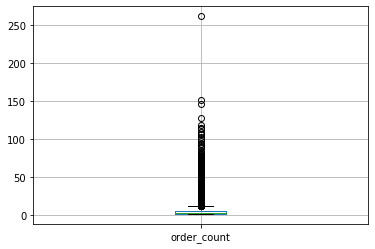

In [5]:
#Initial ED&A

#number of orders in dataset
print('Orders Per Customer:')
print('Total number of orders in dataset:', sum(orders['order_count']))
#number of orders per customer
cust_agg = orders.groupby(['customer_id']).sum()
cust_agg.head()
boxplot = cust_agg.boxplot(column = ['order_count'])
print(boxplot)
print(cust_agg['order_count'].describe())
print('50% of customers have at least 2 orders, there are lots of high outliers')
print(cust_agg.count())
cust_agg_multiples = cust_agg[cust_agg['order_count'] > 1]
print('Number of customers who have ordered more than 1 time:', cust_agg_multiples.count())


#ED&A
#date duration of dataset
orders['created_at'] = orders['created_at'].astype('datetime64[ns]')
orders['just_date'] = orders['created_at'].dt.date
print(orders['just_date'].min())
print(orders['just_date'].max())

#latest delivery date
#time & order count line chart
aggprep = orders[['just_date', 'order_count']]
# print(aggprep.head())
groupby = aggprep.groupby('just_date').agg('sum').reset_index()
# print(groupby.head())
fig = px.line(groupby, x = 'just_date', y = 'order_count')
fig.show()

# Variable Creation


In [6]:
#variable creations
#frequency (order count), monetary, average_monetary
orders['grand_total'] = orders['grand_total'].astype('float')
orders['deliverydistance'] = orders['deliverydistance'].astype('float')
orders['item_count'] = orders['item_count'].astype('float')
customer_behavior = orders.groupby('customer_id', as_index=False).agg({'just_date': ['max'], 
                                                       'order_count': ['sum'], 
                                                       'grand_total': ['mean', 'sum'],
                                                        'vendor_id': ['nunique'],
                                                        'deliverydistance': ['mean'],
                                                        'item_count': ['mean']}).reset_index()
customer_behavior.columns = list(map('_'.join, customer_behavior.columns.values))
# print(customer_behavior['customer_id_'].count())
# print(customer_behavior['customer_id_'].nunique())

#recency
customer_behavior['last_date'] = '2020-02-29'
customer_behavior['last_date'] = customer_behavior['last_date'].astype('datetime64[ns]')
customer_behavior['just_date_max'] = customer_behavior['just_date_max'].astype('datetime64[ns]')
customer_behavior['Recency'] = customer_behavior['just_date_max'].sub(customer_behavior['last_date'], axis=0)
customer_behavior['Recency'] = customer_behavior['Recency'] / np.timedelta64(1, 'D')

#periodicity
#need customer and dates seperated by commas
cust_dates = orders[['customer_id', 'created_at']]
cust_dates.head()
#sort by cust_id then date
cust_dates = cust_dates.sort_values(['customer_id', 'created_at'], ascending = [1, 1])
cust_dates.head()
#shift
cust_dates['previous_visit'] = cust_dates.groupby(['customer_id'])['created_at'].shift()
cust_dates.head()
#difference in dates
cust_dates['days_bw_visits'] = (cust_dates['created_at'] - cust_dates['previous_visit']).dt.days
cust_dates.head()
#average
cust_dates_final = cust_dates.groupby('customer_id')['days_bw_visits'].agg('mean')
# df['days_bw_visits'].mean()
cust_dates_final.head()
#join
dataset = customer_behavior.merge(cust_dates_final, left_on='customer_id_', right_on='customer_id')
dataset.head()

#length
customers = customers[['akeed_customer_id', 'created_at']]
# dup_check = customers[customers.duplicated(subset=['akeed_customer_id'])]
# print(dup_check)
customers = customers.drop_duplicates(subset = 'akeed_customer_id')
customer_behavior = dataset.merge(customers, left_on='customer_id_', right_on='akeed_customer_id', how = 'left')

#created at - last date order date
customer_behavior['created_at'] = customer_behavior['created_at'].astype('datetime64[ns]')
customer_behavior['Length'] = customer_behavior['just_date_max'].sub(customer_behavior['created_at'], axis=0)
customer_behavior['Length'] = customer_behavior['Length'] / np.timedelta64(1, 'D')

#only 2+ order customers
customer_behavior = customer_behavior[customer_behavior['order_count_sum'] > 1]
#orders per location
customer_behavior['oders_per_location'] = customer_behavior['order_count_sum']/customer_behavior['vendor_id_nunique']

#average vendor rating ordered from, average delivery charge, average prep time
orders['vendor_id'] = orders['vendor_id'].astype('int')
vendor_info = orders.merge(vendors, left_on='vendor_id', right_on='id')
vendor_info2 = vendor_info.groupby('customer_id', as_index=False).agg({'vendor_rating_y': ['mean'], 
                                                       'delivery_charge': ['mean'], 
                                                       'prepration_time': ['mean']}).reset_index()
vendor_info2.columns = list(map('_'.join, vendor_info2.columns.values))
vendor_info2.head()
customer_behavior = customer_behavior.merge(vendor_info2, left_on='customer_id_', right_on='customer_id_')

#time of order? count breakfast, lunch, dinner, late night
    #group breakfast & count (5am - 10am) lunch (10am - 4pm) dinner (4pm - 9pm) late night (9pm - 5am)
orders['created_at'] = orders['created_at'].astype('datetime64[ns]')
orders['hour'] = orders['created_at'].dt.hour
orders['breakfast'] = np.where((orders['hour'] > 4) & ((orders['hour'] <= 9)), 1, 0)
orders['lunch'] = np.where((orders['hour'] > 9) & ((orders['hour'] <= 15)), 1, 0)
orders['dinner'] = np.where((orders['hour'] > 15) & ((orders['hour'] <= 20)), 1, 0)
orders['late_night'] = np.where((orders['hour'] > 20) | ((orders['hour'] <= 4)), 1, 0)
orders['total'] = orders['breakfast'] + orders['lunch'] + orders['dinner'] + orders['late_night']
#group
timing = orders.groupby('customer_id', as_index=False).agg({'breakfast': ['sum'], 
                                                       'lunch': ['sum'], 
                                                       'dinner': ['sum'],
                                                       'late_night': ['sum'],
                                                       'total': ['sum']}).reset_index()
timing.columns = list(map('_'.join, timing.columns.values))
#ratios
timing['breakfast_r'] = timing['breakfast_sum'] / timing['total_sum']
timing['lunch_r'] = timing['lunch_sum'] / timing['total_sum']
timing['dinner_r'] = timing['dinner_sum'] / timing['total_sum']
timing['late_nigh_r'] = timing['late_night_sum'] / timing['total_sum']
#merge back 
timing = timing[['customer_id_', 'breakfast_r', 'lunch_r', 'dinner_r', 'late_nigh_r']]
customer_behavior = customer_behavior.merge(timing, left_on='customer_id_', right_on='customer_id_')
customer_behavior.head()


,index__x,customer_id_,just_date_max,order_count_sum,grand_total_mean,grand_total_sum,vendor_id_nunique,deliverydistance_mean,item_count_mean,last_date,Recency,days_bw_visits,akeed_customer_id,created_at,Length,oders_per_location,index__y,vendor_rating_y_mean,delivery_charge_mean,prepration_time_mean,breakfast_r,lunch_r,dinner_r,late_nigh_r
0,2,005ECL6,2020-01-17,2,24.350000,48.7,1,6.630000,4.5,2020-02-29,-43.0,27.000000,005ECL6,2019-12-30 11:44:14,17.510949,2.0,2,4.60,0.700000,15.000000,0.0,0.000000,0.500000,0.500000
1,4,009UFS1,2019-12-12,4,7.400000,29.6,4,1.995000,1.5,2020-02-29,-79.0,61.333333,009UFS1,2018-07-07 21:59:21,522.083785,1.0,4,4.20,0.525000,15.500000,0.0,0.000000,0.000000,1.000000
2,7,00GV4J4,2020-01-30,3,12.466667,37.4,3,0.646667,1.0,2020-02-29,-30.0,69.000000,00GV4J4,2019-09-20 21:56:11,131.085984,1.0,7,4.30,0.233333,11.666667,0.0,0.666667,0.000000,0.333333
3,8,00HRRAK,2020-02-25,6,17.716667,106.3,3,6.400000,2.0,2020-02-29,-4.0,9.000000,00HRRAK,2020-01-17 20:21:50,38.151505,2.0,8,4.70,0.000000,15.500000,0.0,0.333333,0.500000,0.166667
4,9,00HWUU3,2019-12-31,6,6.200000,37.2,6,1.726667,1.2,2020-02-29,-60.0,15.800000,00HWUU3,2019-01-01 01:33:01,363.935405,1.0,9,4.15,0.233333,13.166667,0.0,0.166667,0.333333,0.500000


# ED&A Following Variable Creation

17526
17526
index__x                   0
customer_id_               0
just_date_max              0
order_count_sum            0
grand_total_mean           0
grand_total_sum            0
vendor_id_nunique          0
deliverydistance_mean      0
item_count_mean           51
last_date                  0
Recency                    0
days_bw_visits             0
akeed_customer_id        424
created_at               424
Length                   424
oders_per_location         0
index__y                   0
vendor_rating_y_mean       0
delivery_charge_mean       0
prepration_time_mean       0
breakfast_r                0
lunch_r                    0
dinner_r                   0
late_nigh_r                0
dtype: int64
       order_count_sum  grand_total_mean  grand_total_sum  vendor_id_nunique  \
count     17526.000000      17526.000000     17526.000000       17526.000000   
mean          7.154171         15.067164       110.325710           3.512781   
std           8.790669          8.95948

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x000001F4F3BE7A08>]],
      dtype=object)

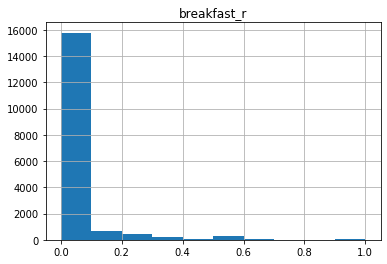

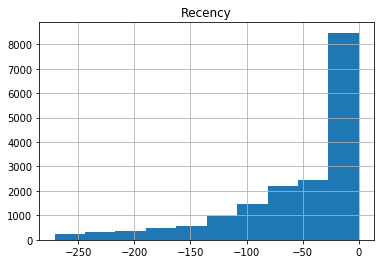

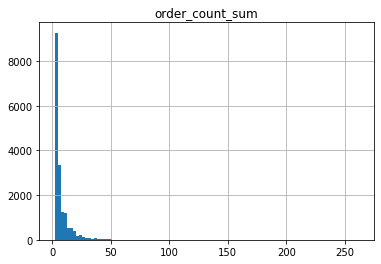

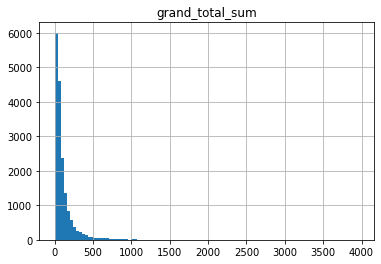

In [7]:
#ED&A Following Variable Creation & any data cleaning
print(customer_behavior['customer_id_'].nunique())
print(customer_behavior['index__x'].count())

#nulls
print(customer_behavior.isnull().sum(axis = 0))

#if length is less than 0, make 0
customer_behavior['Length'] = np.where((customer_behavior['Length'] < 0), 0, customer_behavior['Length'])


print(customer_behavior[['order_count_sum', 'grand_total_mean', 'grand_total_sum', 
                         'vendor_id_nunique', 'deliverydistance_mean', 'item_count_mean', 
                         'Recency', 'days_bw_visits', 'Length', 'oders_per_location',
                        'vendor_rating_y_mean', 'delivery_charge_mean', 'prepration_time_mean',
                        'breakfast_r', 'lunch_r', 'dinner_r', 'late_nigh_r']].describe())


#look at distribution of breakfast_r, all time ratios
customer_behavior.hist(column = 'breakfast_r')
#overall time ratios
print('Breakfast Ratio:', orders['breakfast'].sum()/orders['order_count'].sum())
print('Lunch Ratio:', orders['lunch'].sum()/orders['order_count'].sum())
print('Dinner Ratio:', orders['dinner'].sum()/orders['order_count'].sum())
print('Late Night Ratio:', orders['late_night'].sum()/orders['order_count'].sum())


#histograms of RFM Variables
customer_behavior.hist(column = 'Recency')
customer_behavior.hist(column = 'order_count_sum', bins = 100)
customer_behavior.hist(column = 'grand_total_sum', bins = 100)



In [7]:
#count outliers for order total
grant_total_sum = customer_behavior[['grand_total_sum']]
Q1 = grant_total_sum.quantile(0.25)
Q3 = grant_total_sum.quantile(0.75)
IQR = Q3 - Q1
print(((grant_total_sum < (Q1 - 1.5 * IQR)) | (grant_total_sum > (Q3 + 1.5 * IQR))).sum())

customer_behavior.shape

grand_total_sum    1556
dtype: int64


(17526, 24)

# Clustering

## RFM

### Baseline RFM Cluster - Standardized with Outliers

#### Clustering Code

In [79]:
#clustering - RFM

#rfm dataset
customer_behavior['Recency'] = customer_behavior['Recency'].abs()
rfm_data = customer_behavior[['customer_id_', 'Recency', 'order_count_sum', 'grand_total_sum']]
rfm_data_noid = customer_behavior[['Recency', 'order_count_sum', 'grand_total_sum']]
rfm_data_noid.head()

#data pre-processing (same scale)
scaler = StandardScaler()
scaled_rfm = scaler.fit_transform(rfm_data_noid)
scaled_rfm[:5]

#cluster
kmeans = KMeans(
    init="random",
    n_clusters=3,
    n_init=10,
    max_iter=300,
    random_state=42
)

print(kmeans.fit(scaled_rfm))

#lowest SSE value
print('lowest SSE value', kmeans.inertia_)
#final locations of centroid
print('final locations of centroid', kmeans.cluster_centers_)
#number of iterations required to converge
print('number of iterations required to converge', kmeans.n_iter_)

#cluster assignments stored as a 1d np array
print('cluster assignments:', kmeans.labels_[:5])

KMeans(algorithm='auto', copy_x=True, init='random', max_iter=300, n_clusters=3,
       n_init=10, n_jobs=None, precompute_distances='auto', random_state=42,
       tol=0.0001, verbose=0)
lowest SSE value 21432.928806250515
final locations of centroid [[-0.64518623  2.84521547  2.80765828]
 [ 1.54193808 -0.40932594 -0.3424372 ]
 [-0.44366064 -0.11331975 -0.13173857]]
number of iterations required to converge 14
cluster assignments: [2 2 2 2 2]


#### Determining Number of Clusters

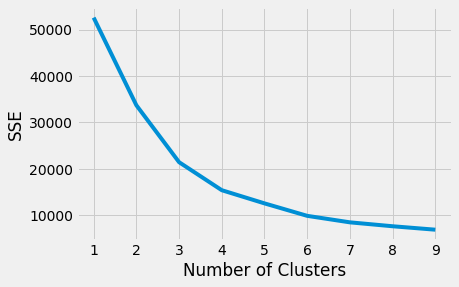

4


In [80]:
#choosing the appropriate number of clusters

#elbow
kmeans_kwargs = {
    "init": "random",
    "n_init": 10,
    "max_iter": 300,
    "random_state": 42,
}

# A list holds the SSE values for each k
sse = []
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(scaled_rfm)
    sse.append(kmeans.inertia_)
    
#plot
plt.style.use("fivethirtyeight")
plt.plot(range(1, 10), sse)
plt.xticks(range(1, 10))
plt.xlabel("Number of Clusters")
plt.ylabel("SSE")
plt.show()

#programatically calculating where the elbow point is:
kl = KneeLocator(
    range(1, 10), sse, curve="convex", direction="decreasing"
)

print(kl.elbow)

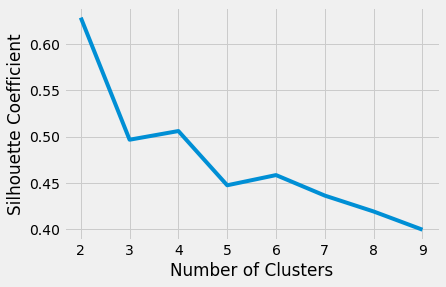

In [81]:
#silhouette coefficient

# A list holds the silhouette coefficients for each k
silhouette_coefficients = []

# Notice you start at 2 clusters for silhouette coefficient
for k in range(2, 10):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(scaled_rfm)
    score = silhouette_score(scaled_rfm, kmeans.labels_)
    silhouette_coefficients.append(score)
                                   
plt.style.use("fivethirtyeight")
plt.plot(range(2, 10), silhouette_coefficients)
plt.xticks(range(2, 10))
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Coefficient")
plt.show()

#### Interpret & Visualize

In [82]:
#clustering interpretation

#get descriptive stats on each variable
print(rfm_data_noid[['Recency', 'order_count_sum', 'grand_total_sum']].describe())

#Dataframe
model_clus4 = KMeans(n_clusters = 4, max_iter=50)
model_clus4.fit(scaled_rfm)
RFM_km = pd.concat([rfm_data, pd.Series(model_clus4.labels_)], axis=1)
RFM_km.columns = ['CustomerID', 'Recency', 'Frequency', 'Monetary', 'ClusterID']
# RFM_km
# RFM_km.Recency = RFM_km.Recency.dt.days
km_clusters_amount = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Recency.mean())
km_clusters_frequency = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Frequency.mean())
km_clusters_recency = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Monetary.mean())
km_clusters_count = pd.DataFrame(RFM_km.groupby(["ClusterID"]).count())

print(km_clusters_amount)
print(km_clusters_frequency)
print(km_clusters_recency)
print(km_clusters_count)

            Recency  order_count_sum  grand_total_sum
count  17526.000000     17526.000000     17526.000000
mean      54.600080         7.154171       110.325710
std       60.285566         8.790669       166.768643
min        0.000000         2.000000         0.000000
25%       10.000000         2.000000        30.700000
50%       29.000000         4.000000        59.000000
75%       82.000000         8.000000       123.400000
max      271.000000       262.000000      3965.500000
              Recency
ClusterID            
0            7.754098
1           29.744367
2           20.153700
3          151.240423
           Frequency
ClusterID           
0          57.928962
1           5.051092
2          20.665560
3           3.536328
              Monetary
ClusterID             
0          1166.773770
1            70.638183
2           337.140038
3            52.985575
           CustomerID  Recency  Frequency  Monetary
ClusterID                                          
0             

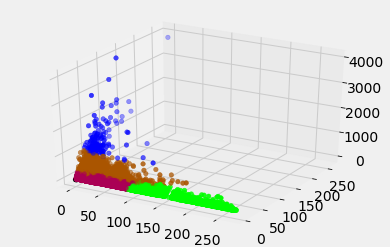

In [83]:
#visualizing rfm - 3d
from mpl_toolkits.mplot3d import Axes3D # <--- This is important for 3d plotting 

centers = model_clus4.cluster_centers_
fig=plt.figure()
ax = fig.add_subplot(111, projection = '3d')
ax.scatter(RFM_km['Recency'],RFM_km['Frequency'], RFM_km['Monetary'], cmap="brg", c=RFM_km['ClusterID'])
ax.scatter(centers[:, 0], centers[:, 1], c = 'black');

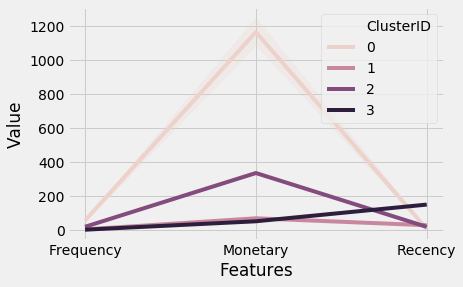

In [84]:
#visualizing with line plots

melted_rfm = pd.melt(RFM_km.reset_index(), 
                    id_vars =  ['CustomerID', 'ClusterID'],
                    value_vars = ['Recency', 'Frequency', 'Monetary'],
                    var_name = 'Features', 
                    value_name = 'Value')

sns.lineplot('Features', 'Value', hue = 'ClusterID', data = melted_rfm)
plt.legend()

#cluster 0 are customers with low frequency, monetary, 
#and it's differentiating factor is high recency which is bad (they haven't ordered in a while)
#these customers have stopped using the app and could benefit from increased engagement incentives

#cluster 1 are your better than expected but not outstanding customers, they have higher frequency, lower recency, and higher spend
#these customers are engaged & spending money and considered valueable

#cluster 2 is the largest group - these are just average customers they have relatively low frequnecy, lower monetary, but have low recency
#this group would also include newer customers
#these customers could benefit from messaging to keep them engaged

#cluster 3 is the smallest group but they are high value customers
#they have the highest frequency, highest spending, and lowest recency
#these customers should be retained and their loyalty should be rewarded

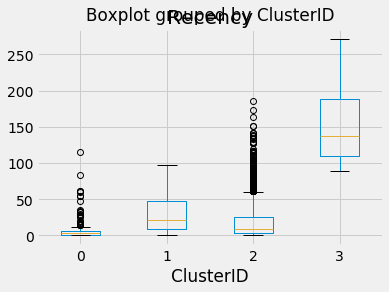

In [85]:

# RFM_km.columns = ['CustomerID', 'Recency', 'Frequency', 'Monetary', 'ClusterID']
RFM_km.boxplot(column = 'Recency', by = 'ClusterID')

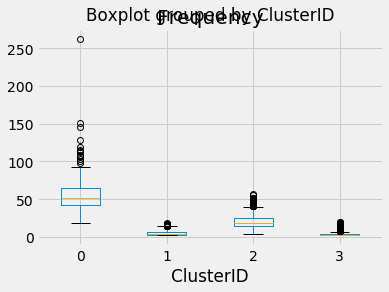

In [86]:
RFM_km.boxplot(column = 'Frequency', by = 'ClusterID')

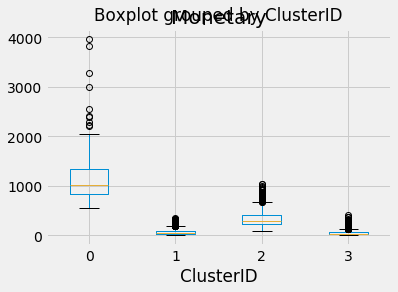

In [87]:
RFM_km.boxplot(column = 'Monetary', by = 'ClusterID')

### Clustering RFM - No Outliers

count    17526.000000
mean        54.600080
std         60.285566
min          0.000000
25%         10.000000
50%         29.000000
75%         82.000000
max        271.000000
Name: Recency, dtype: float64

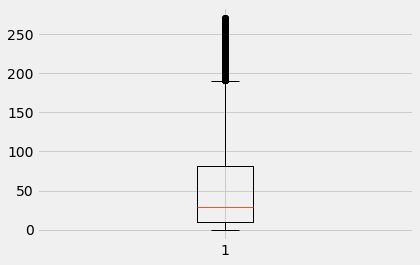

In [88]:
rfm_data = customer_behavior[['customer_id_', 'Recency', 'order_count_sum', 'grand_total_sum']]
rfm_data.head()
plt.boxplot(rfm_data.Recency)
rfm_data['Recency'].describe()

count    16623.000000
mean        45.279974
std         46.056632
min          0.000000
25%          9.000000
50%         27.000000
75%         72.000000
max        190.000000
Name: Recency, dtype: float64

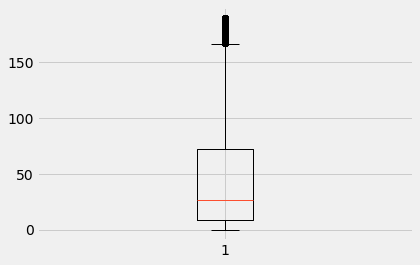

In [89]:
#recency outlier treatment
Q1 = rfm_data.Recency.quantile(0.25)
Q3 = rfm_data.Recency.quantile(0.75)
IQR = Q3 - Q1
rfm_data = rfm_data[(rfm_data.Recency >= (Q1 - 1.5*IQR)) & (rfm_data.Recency <= (Q3 + 1.5*IQR))]
plt.boxplot(rfm_data.Recency)
rfm_data['Recency'].describe()

            Recency  order_count_sum  grand_total_sum
count  14505.000000     14505.000000     14505.000000
mean      48.683282         5.024681        67.880931
std       46.958440         3.512969        50.337940
min        0.000000         2.000000         0.000000
25%       11.000000         2.000000        28.700000
50%       30.000000         4.000000        51.900000
75%       77.000000         7.000000        93.800000
max      190.000000        19.000000       224.300000
            Recency  order_count_sum  grand_total_sum
count  14505.000000     14505.000000     14505.000000
mean      48.683282         5.024681        67.880931
std       46.958440         3.512969        50.337940
min        0.000000         2.000000         0.000000
25%       11.000000         2.000000        28.700000
50%       30.000000         4.000000        51.900000
75%       77.000000         7.000000        93.800000
max      190.000000        19.000000       224.300000


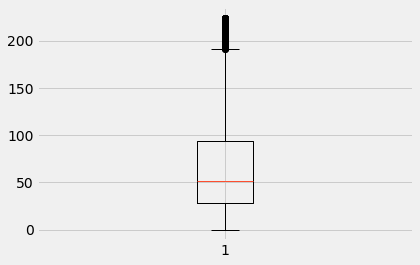

In [90]:
#Tweaks

#outlier treatment
    #becuse we have a small group with high values and not a super even spread with clusters, I'm going to tweak with an outlier treatment as we know there are a lot of high outliers in the data

rfm_data = customer_behavior[['customer_id_', 'Recency', 'order_count_sum', 'grand_total_sum']]

#recency
# plt.boxplot(rfm_data_noid.Recency)
Q1 = rfm_data.Recency.quantile(0.25)
Q3 = rfm_data.Recency.quantile(0.75)
IQR = Q3 - Q1
rfm_data = rfm_data[(rfm_data.Recency >= (Q1 - 1.5*IQR)) & (rfm_data.Recency <= (Q3 + 1.5*IQR))]

#frequency
# plt.boxplot(rfm_data_noid.order_count_sum)
Q1 = rfm_data.order_count_sum.quantile(0.25)
Q3 = rfm_data.order_count_sum.quantile(0.75)
IQR = Q3 - Q1
rfm_data = rfm_data[(rfm_data.order_count_sum >= (Q1 - 1.5*IQR)) & (rfm_data.order_count_sum <= (Q3 + 1.5*IQR))]

#monetary
# plt.boxplot(rfm_data_noid.grand_total_sum)
Q1 = rfm_data.grand_total_sum.quantile(0.25)
Q3 = rfm_data.grand_total_sum.quantile(0.75)
IQR = Q3 - Q1
rfm_data = rfm_data[(rfm_data.grand_total_sum >= (Q1 - 1.5*IQR)) & (rfm_data.grand_total_sum <= (Q3 + 1.5*IQR))]

plt.boxplot(rfm_data.grand_total_sum)
print(rfm_data[['Recency', 'order_count_sum', 'grand_total_sum']].describe())
rfm_data_noid = rfm_data[['Recency', 'order_count_sum', 'grand_total_sum']]
print(rfm_data_noid[['Recency', 'order_count_sum', 'grand_total_sum']].describe())

#hopkins statistics


KMeans(algorithm='auto', copy_x=True, init='random', max_iter=300, n_clusters=3,
       n_init=10, n_jobs=None, precompute_distances='auto', random_state=42,
       tol=0.0001, verbose=0)
lowest SSE value 15562.456824998459
final locations of centroid [[ 1.3985465  -0.4870147  -0.43797252]
 [-0.52493143 -0.4188921  -0.44934235]
 [-0.40097512  1.39809977  1.40922707]]
number of iterations required to converge 8


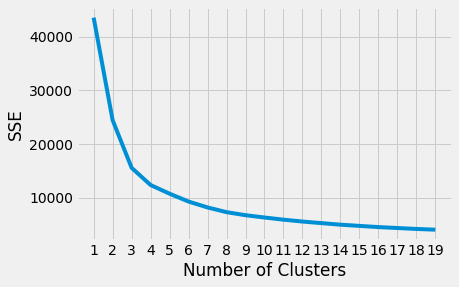

4


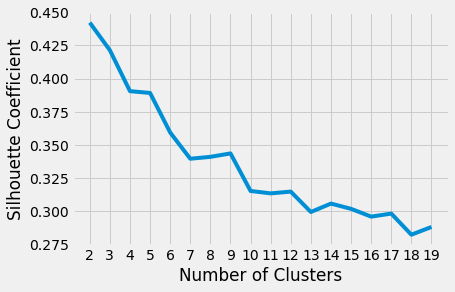

In [91]:
#clustering - RFM without outliers

#data pre-processing (same scale)
scaler = StandardScaler()
scaled_rfm = scaler.fit_transform(rfm_data_noid)
# scaled_rfm[:5]

#cluster
kmeans = KMeans(
    init="random",
    n_clusters=3,
    n_init=10,
    max_iter=300,
    random_state=42
)

print(kmeans.fit(scaled_rfm))

#lowest SSE value
print('lowest SSE value', kmeans.inertia_)
#final locations of centroid
print('final locations of centroid', kmeans.cluster_centers_)
#number of iterations required to converge
print('number of iterations required to converge', kmeans.n_iter_)

#cluster assignments stored as a 1d np array
# print('cluster assignments:', kmeans.labels_[:5])

#choosing the appropriate number of clusters

#elbow
kmeans_kwargs = {
    "init": "random",
    "n_init": 10,
    "max_iter": 300,
    "random_state": 42,
}

# A list holds the SSE values for each k
sse = []
for k in range(1, 20):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(scaled_rfm)
    sse.append(kmeans.inertia_)
    
#plot
plt.style.use("fivethirtyeight")
plt.plot(range(1, 20), sse)
plt.xticks(range(1, 20))
plt.xlabel("Number of Clusters")
plt.ylabel("SSE")
plt.show()

#programatically calculating where the elbow point is:
kl = KneeLocator(
    range(1, 20), sse, curve="convex", direction="decreasing"
)

print(kl.elbow)


#silhouette coefficient

# A list holds the silhouette coefficients for each k
silhouette_coefficients = []

# Notice you start at 2 clusters for silhouette coefficient
for k in range(2, 20):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(scaled_rfm)
    score = silhouette_score(scaled_rfm, kmeans.labels_)
    silhouette_coefficients.append(score)
                                   
plt.style.use("fivethirtyeight")
plt.plot(range(2, 20), silhouette_coefficients)
plt.xticks(range(2, 20))
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Coefficient")
plt.show()

In [92]:
#clustering interpretation

#get descriptive stats on each variable
print(rfm_data_noid[['Recency', 'order_count_sum', 'grand_total_sum']].describe())

#Dataframe
model_clus4 = KMeans(n_clusters = 4, max_iter=50)
model_clus4.fit(scaled_rfm)
RFM_km = pd.concat([rfm_data, pd.Series(model_clus4.labels_)], axis=1)
RFM_km.columns = ['CustomerID', 'Recency', 'Frequency', 'Monetary', 'ClusterID']
# RFM_km
# RFM_km.Recency = RFM_km.Recency.dt.days
km_clusters_amount = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Recency.mean())
km_clusters_frequency = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Frequency.mean())
km_clusters_recency = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Monetary.mean())
km_clusters_count = pd.DataFrame(RFM_km.groupby(["ClusterID"]).count())

print(km_clusters_amount)
print(km_clusters_frequency)
print(km_clusters_recency)
print(km_clusters_count)

            Recency  order_count_sum  grand_total_sum
count  14505.000000     14505.000000     14505.000000
mean      48.683282         5.024681        67.880931
std       46.958440         3.512969        50.337940
min        0.000000         2.000000         0.000000
25%       11.000000         2.000000        28.700000
50%       30.000000         4.000000        51.900000
75%       77.000000         7.000000        93.800000
max      190.000000        19.000000       224.300000
             Recency
ClusterID           
0.0        48.683172
1.0        47.862941
2.0        48.171965
3.0        48.828514
           Frequency
ClusterID           
0.0         5.069945
1.0         5.098968
2.0         4.957370
3.0         4.982204
            Monetary
ClusterID           
0.0        68.398546
1.0        68.677287
2.0        68.475434
3.0        66.848028
           CustomerID  Recency  Frequency  Monetary
ClusterID                                          
0.0              2888     2888  

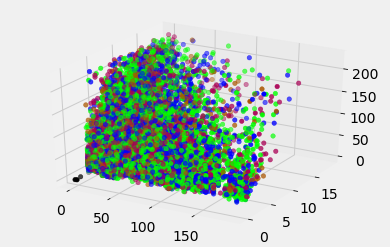

In [93]:
#visualizing rfm - 3d
from mpl_toolkits.mplot3d import Axes3D # <--- This is important for 3d plotting 

centers = model_clus4.cluster_centers_
fig=plt.figure()
ax = fig.add_subplot(111, projection = '3d')
ax.scatter(RFM_km['Recency'],RFM_km['Frequency'], RFM_km['Monetary'], cmap="brg", c=RFM_km['ClusterID'])
ax.scatter(centers[:, 0], centers[:, 1], c = 'black');

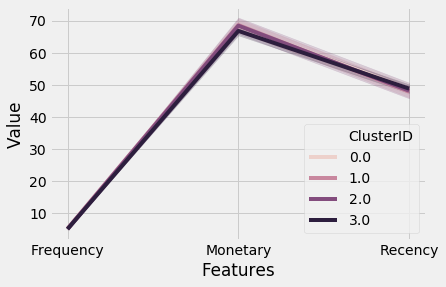

In [94]:
#visualizing with line plots

melted_rfm = pd.melt(RFM_km.reset_index(), 
                    id_vars =  ['CustomerID', 'ClusterID'],
                    value_vars = ['Recency', 'Frequency', 'Monetary'],
                    var_name = 'Features', 
                    value_name = 'Value')

sns.lineplot('Features', 'Value', hue = 'ClusterID', data = melted_rfm)
plt.legend()

### Clustering RFM - Normalization with Outliers

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x000001F4811292C8>,
      dtype=object)

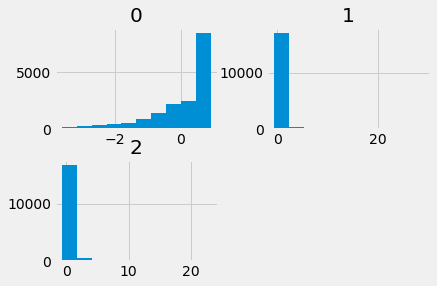

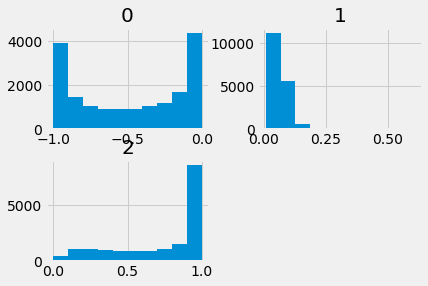

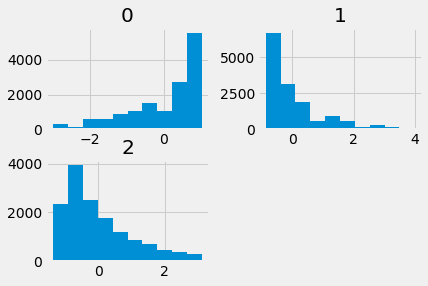

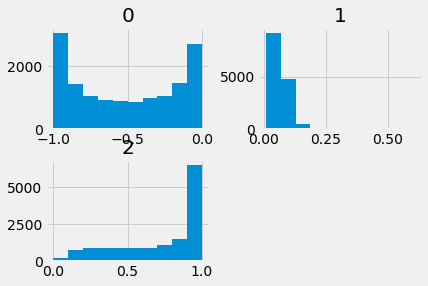

In [11]:
#try normalization instead of standardization (both with and without outliers), compare to the above
    #after normalizing compare histograms

#comparison of distributions

#just normalization - no outlier removal
    #comparison of distributions
rfm_data = customer_behavior[['customer_id_', 'Recency', 'order_count_sum', 'grand_total_sum']]
rfm_data_noid = rfm_data[['Recency', 'order_count_sum', 'grand_total_sum']]

scaler = StandardScaler()
scaled_rfm = scaler.fit_transform(rfm_data_noid)
from pandas import DataFrame
standardized = DataFrame(scaled_rfm)
standardized.hist()

from sklearn.preprocessing import Normalizer
transformer = Normalizer().fit(rfm_data_noid)
normalized_rfm = transformer.transform(rfm_data_noid)
normalized = DataFrame(normalized_rfm)
normalized.hist()

#with outlier removal

#recency
# plt.boxplot(rfm_data_noid.Recency)
Q1 = rfm_data.Recency.quantile(0.25)
Q3 = rfm_data.Recency.quantile(0.75)
IQR = Q3 - Q1
rfm_data = rfm_data[(rfm_data.Recency >= (Q1 - 1.5*IQR)) & (rfm_data.Recency <= (Q3 + 1.5*IQR))]

#frequency
# plt.boxplot(rfm_data_noid.order_count_sum)
Q1 = rfm_data.order_count_sum.quantile(0.25)
Q3 = rfm_data.order_count_sum.quantile(0.75)
IQR = Q3 - Q1
rfm_data = rfm_data[(rfm_data.order_count_sum >= (Q1 - 1.5*IQR)) & (rfm_data.order_count_sum <= (Q3 + 1.5*IQR))]

#monetary
# plt.boxplot(rfm_data_noid.grand_total_sum)
Q1 = rfm_data.grand_total_sum.quantile(0.25)
Q3 = rfm_data.grand_total_sum.quantile(0.75)
IQR = Q3 - Q1
rfm_data = rfm_data[(rfm_data.grand_total_sum >= (Q1 - 1.5*IQR)) & (rfm_data.grand_total_sum <= (Q3 + 1.5*IQR))]

rfm_data_noid_nooutliers = rfm_data[['Recency', 'order_count_sum', 'grand_total_sum']]

scaler = StandardScaler()
scaled_rfm = scaler.fit_transform(rfm_data_noid_nooutliers)
from pandas import DataFrame
standardized_no_outliers = DataFrame(scaled_rfm)
standardized_no_outliers.hist()

transformer = Normalizer().fit(rfm_data_noid_nooutliers)
normalized_rfm = transformer.transform(rfm_data_noid_nooutliers)
normalized_no_outliers = DataFrame(normalized_rfm)
normalized_no_outliers.hist()


KMeans(algorithm='auto', copy_x=True, init='random', max_iter=300, n_clusters=3,
       n_init=10, n_jobs=None, precompute_distances='auto', random_state=42,
       tol=0.0001, verbose=0)
lowest SSE value 363.618960593402
final locations of centroid [[-0.62024171  0.06485264  0.76319916]
 [-0.94248588  0.02953321  0.29487151]
 [-0.12598124  0.07339137  0.98180933]]
number of iterations required to converge 14


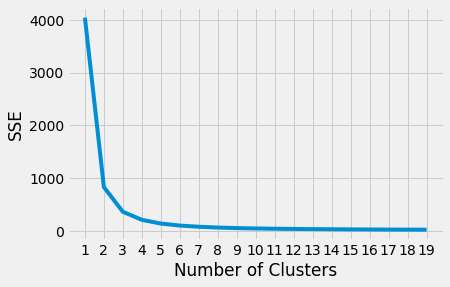

3


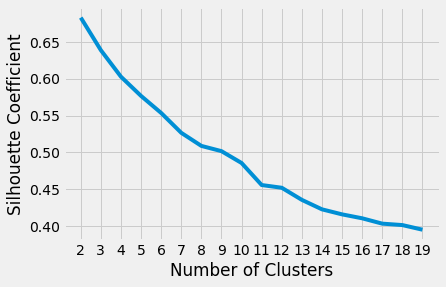

In [12]:
#clustering with normalization
#clustering - RFM with outliers

rfm_data = customer_behavior[['customer_id_', 'Recency', 'order_count_sum', 'grand_total_sum']]
rfm_data_noid = rfm_data[['Recency', 'order_count_sum', 'grand_total_sum']]

#data pre-processing (normalized)
transformer = Normalizer().fit(rfm_data_noid)
scaled_rfm = transformer.transform(rfm_data_noid)

# scaled_rfm[:5]

#cluster
kmeans = KMeans(
    init="random",
    n_clusters=3,
    n_init=10,
    max_iter=300,
    random_state=42
)

print(kmeans.fit(scaled_rfm))

#lowest SSE value
print('lowest SSE value', kmeans.inertia_)
#final locations of centroid
print('final locations of centroid', kmeans.cluster_centers_)
#number of iterations required to converge
print('number of iterations required to converge', kmeans.n_iter_)

#cluster assignments stored as a 1d np array
# print('cluster assignments:', kmeans.labels_[:5])

#choosing the appropriate number of clusters

#elbow
kmeans_kwargs = {
    "init": "random",
    "n_init": 10,
    "max_iter": 300,
    "random_state": 42,
}

# A list holds the SSE values for each k
sse = []
for k in range(1, 20):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(scaled_rfm)
    sse.append(kmeans.inertia_)
    
#plot
plt.style.use("fivethirtyeight")
plt.plot(range(1, 20), sse)
plt.xticks(range(1, 20))
plt.xlabel("Number of Clusters")
plt.ylabel("SSE")
plt.show()

#programatically calculating where the elbow point is:
kl = KneeLocator(
    range(1, 20), sse, curve="convex", direction="decreasing"
)

print(kl.elbow)


#silhouette coefficient

# A list holds the silhouette coefficients for each k
silhouette_coefficients = []

# Notice you start at 2 clusters for silhouette coefficient
for k in range(2, 20):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(scaled_rfm)
    score = silhouette_score(scaled_rfm, kmeans.labels_)
    silhouette_coefficients.append(score)
                                   
plt.style.use("fivethirtyeight")
plt.plot(range(2, 20), silhouette_coefficients)
plt.xticks(range(2, 20))
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Coefficient")
plt.show()

In [13]:
silhouette_coefficients

[0.6830359613145396,
 0.6387933033072198,
 0.6027808939301603,
 0.5766998212862933,
 0.5535758625808888,
 0.5266392661445706,
 0.5088876866673052,
 0.5017518835469628,
 0.48567269652562917,
 0.45576301715658163,
 0.4520515470992801,
 0.4356163390210754,
 0.42276597744336997,
 0.4159386306049894,
 0.4106014057576521,
 0.4033361209144322,
 0.4014042868740761,
 0.39512613884034625]

In [14]:
sse

[4045.5358458530764,
 831.5906945489432,
 363.618960593402,
 210.8330267901941,
 140.3680315150106,
 102.21032156294532,
 79.90790825754668,
 64.61100168049954,
 53.93782965204938,
 47.48528100800362,
 42.16890764490187,
 38.170343808394314,
 35.31950101619246,
 32.31930848742119,
 29.949186946381488,
 27.85557349078666,
 26.285604939390627,
 24.995826270587273,
 23.88898641148837]

In [16]:
#clustering interpretation

#get descriptive stats on each variable
print(rfm_data_noid[['Recency', 'order_count_sum', 'grand_total_sum']].describe())

#Dataframe
model_clus4 = KMeans(n_clusters = 3, max_iter=50)
model_clus4.fit(scaled_rfm)
RFM_km = pd.concat([rfm_data, pd.Series(model_clus4.labels_)], axis=1)
RFM_km.columns = ['CustomerID', 'Recency', 'Frequency', 'Monetary', 'ClusterID']
# RFM_km
# RFM_km.Recency = RFM_km.Recency.dt.days
km_clusters_amount = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Recency.mean())
km_clusters_frequency = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Frequency.mean())
km_clusters_recency = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Monetary.mean())
km_clusters_count = pd.DataFrame(RFM_km.groupby(["ClusterID"]).count())

print(km_clusters_amount)
print(km_clusters_frequency)
print(km_clusters_recency)
print(km_clusters_count)

            Recency  order_count_sum  grand_total_sum
count  17526.000000     17526.000000     17526.000000
mean     -54.600080         7.154171       110.325710
std       60.285566         8.790669       166.768643
min     -271.000000         2.000000         0.000000
25%      -82.000000         2.000000        30.700000
50%      -29.000000         4.000000        59.000000
75%      -10.000000         8.000000       123.400000
max        0.000000       262.000000      3965.500000
              Recency
ClusterID            
0          -53.283589
1          -14.911843
2         -120.827141
           Frequency
ClusterID           
0           4.697048
1          11.037539
2           2.849990
             Monetary
ClusterID            
0           65.809256
1          180.011855
2           33.444924
           CustomerID  Recency  Frequency  Monetary
ClusterID                                          
0                4235     4235       4235      4235
1                8258     8258   

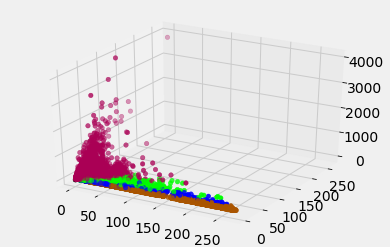

In [98]:
#visualizing rfm - 3d
from mpl_toolkits.mplot3d import Axes3D # <--- This is important for 3d plotting 

centers = model_clus4.cluster_centers_
fig=plt.figure()
ax = fig.add_subplot(111, projection = '3d')
ax.scatter(RFM_km['Recency'],RFM_km['Frequency'], RFM_km['Monetary'], cmap="brg", c=RFM_km['ClusterID'])
ax.scatter(centers[:, 0], centers[:, 1], c = 'black');

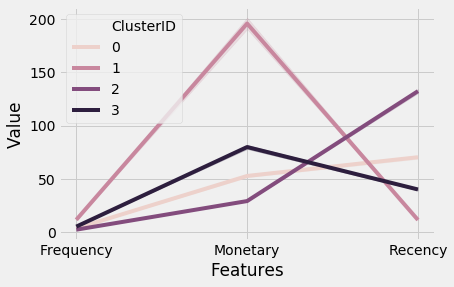

In [99]:
#visualizing with line plots

melted_rfm = pd.melt(RFM_km.reset_index(), 
                    id_vars =  ['CustomerID', 'ClusterID'],
                    value_vars = ['Recency', 'Frequency', 'Monetary'],
                    var_name = 'Features', 
                    value_name = 'Value')

sns.lineplot('Features', 'Value', hue = 'ClusterID', data = melted_rfm)
plt.legend()

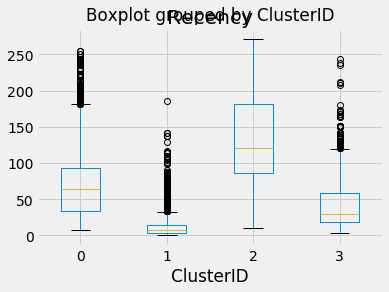

In [100]:
RFM_km.boxplot(column = 'Recency', by = 'ClusterID')

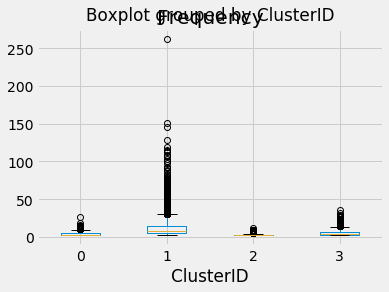

In [101]:
RFM_km.boxplot(column = 'Frequency', by = 'ClusterID')

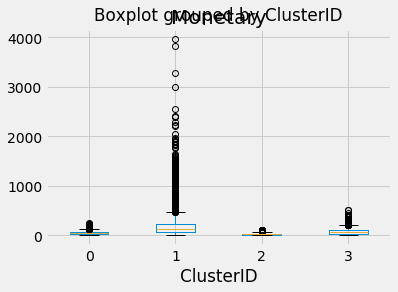

In [102]:
RFM_km.boxplot(column = 'Monetary', by = 'ClusterID')

Seeing the best separation here. Results are more evenly spread among customers
Cluster 0 is the highest value customer with high freq, monetary, and lowest recency.
Cluster 1 is the low freq/low total spend, high recency customers who have most likely stopped using the app. 
Cluster 2 is the average customer, they have better recency (still using the app) higher monetary and higher frequency than those who have stopped using the app.

### RFM Clustering - normalization without outliers. 

In [9]:
#setting up data
rfm_data = customer_behavior[['customer_id_', 'Recency', 'order_count_sum', 'grand_total_sum']]
#recency
# plt.boxplot(rfm_data_noid.Recency)
Q1 = rfm_data.Recency.quantile(0.25)
Q3 = rfm_data.Recency.quantile(0.75)
IQR = Q3 - Q1
rfm_data = rfm_data[(rfm_data.Recency >= (Q1 - 1.5*IQR)) & (rfm_data.Recency <= (Q3 + 1.5*IQR))]

#frequency
# plt.boxplot(rfm_data_noid.order_count_sum)
Q1 = rfm_data.order_count_sum.quantile(0.25)
Q3 = rfm_data.order_count_sum.quantile(0.75)
IQR = Q3 - Q1
rfm_data = rfm_data[(rfm_data.order_count_sum >= (Q1 - 1.5*IQR)) & (rfm_data.order_count_sum <= (Q3 + 1.5*IQR))]

#monetary
# plt.boxplot(rfm_data_noid.grand_total_sum)
Q1 = rfm_data.grand_total_sum.quantile(0.25)
Q3 = rfm_data.grand_total_sum.quantile(0.75)
IQR = Q3 - Q1
rfm_data = rfm_data[(rfm_data.grand_total_sum >= (Q1 - 1.5*IQR)) & (rfm_data.grand_total_sum <= (Q3 + 1.5*IQR))]

rfm_data_noid = rfm_data[['Recency', 'order_count_sum', 'grand_total_sum']]

KMeans(algorithm='auto', copy_x=True, init='random', max_iter=300, n_clusters=3,
       n_init=10, n_jobs=None, precompute_distances='auto', random_state=42,
       tol=0.0001, verbose=0)
lowest SSE value 303.0402739329052
final locations of centroid [[-0.15276049  0.07764673  0.97702927]
 [-0.93189391  0.03360994  0.32640727]
 [-0.62074882  0.06534243  0.76485981]]
number of iterations required to converge 17


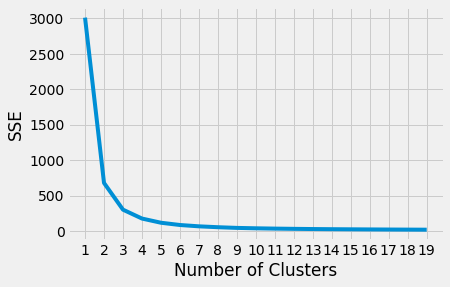

3


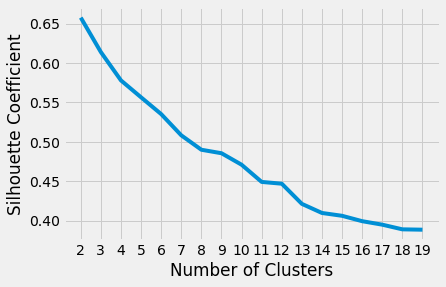

In [10]:
#clustering with normalization
#clustering - RFM without outliers

#data pre-processing (normalized)
transformer = Normalizer().fit(rfm_data_noid)
scaled_rfm = transformer.transform(rfm_data_noid)

# scaled_rfm[:5]

#cluster
kmeans = KMeans(
    init="random",
    n_clusters=3,
    n_init=10,
    max_iter=300,
    random_state=42
)

print(kmeans.fit(scaled_rfm))

#lowest SSE value
print('lowest SSE value', kmeans.inertia_)
#final locations of centroid
print('final locations of centroid', kmeans.cluster_centers_)
#number of iterations required to converge
print('number of iterations required to converge', kmeans.n_iter_)

#cluster assignments stored as a 1d np array
# print('cluster assignments:', kmeans.labels_[:5])

#choosing the appropriate number of clusters

#elbow
kmeans_kwargs = {
    "init": "random",
    "n_init": 10,
    "max_iter": 300,
    "random_state": 42,
}

# A list holds the SSE values for each k
sse = []
for k in range(1, 20):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(scaled_rfm)
    sse.append(kmeans.inertia_)
    
#plot
plt.style.use("fivethirtyeight")
plt.plot(range(1, 20), sse)
plt.xticks(range(1, 20))
plt.xlabel("Number of Clusters")
plt.ylabel("SSE")
plt.show()

#programatically calculating where the elbow point is:
kl = KneeLocator(
    range(1, 20), sse, curve="convex", direction="decreasing"
)

print(kl.elbow)


#silhouette coefficient

# A list holds the silhouette coefficients for each k
silhouette_coefficients = []

# Notice you start at 2 clusters for silhouette coefficient
for k in range(2, 20):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(scaled_rfm)
    score = silhouette_score(scaled_rfm, kmeans.labels_)
    silhouette_coefficients.append(score)
                                   
plt.style.use("fivethirtyeight")
plt.plot(range(2, 20), silhouette_coefficients)
plt.xticks(range(2, 20))
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Coefficient")
plt.show()

In [37]:
#clustering interpretation

#get descriptive stats on each variable
print(rfm_data_noid[['Recency', 'order_count_sum', 'grand_total_sum']].describe())

#Dataframe
model_clus4 = KMeans(n_clusters = 3, max_iter=50)
model_clus4.fit(scaled_rfm)
RFM_km = pd.concat([rfm_data_noid, pd.Series(model_clus4.labels_)], axis=1)
RFM_km.columns = ['Recency', 'Frequency', 'Monetary', 'ClusterID']
# RFM_km
# RFM_km.Recency = RFM_km.Recency.dt.days
km_clusters_amount = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Recency.mean())
km_clusters_frequency = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Frequency.mean())
km_clusters_recency = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Monetary.mean())
km_clusters_count = pd.DataFrame(RFM_km.groupby(["ClusterID"]).count())

print(km_clusters_amount)
print(km_clusters_frequency)
print(km_clusters_recency)
print(km_clusters_count)

            Recency  order_count_sum  grand_total_sum
count  14505.000000     14505.000000     14505.000000
mean      48.683282         5.024681        67.880931
std       46.958440         3.512969        50.337940
min        0.000000         2.000000         0.000000
25%       11.000000         2.000000        28.700000
50%       30.000000         4.000000        51.900000
75%       77.000000         7.000000        93.800000
max      190.000000        19.000000       224.300000
             Recency
ClusterID           
0.0        47.758120
1.0        48.592541
2.0        49.581744
           Frequency
ClusterID           
0.0         5.085212
1.0         5.096020
2.0         4.856830
            Monetary
ClusterID           
0.0        69.281907
1.0        68.040996
2.0        65.236074
           Recency  Frequency  Monetary
ClusterID                              
0.0           5234       5234      5234
1.0           3593       3593      3593
2.0           3199       3199      3199

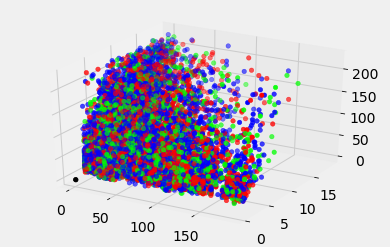

In [38]:
#visualizing rfm - 3d
from mpl_toolkits.mplot3d import Axes3D # <--- This is important for 3d plotting 

centers = model_clus4.cluster_centers_
fig=plt.figure()
ax = fig.add_subplot(111, projection = '3d')
ax.scatter(RFM_km['Recency'],RFM_km['Frequency'], RFM_km['Monetary'], cmap="brg", c=RFM_km['ClusterID'])
ax.scatter(centers[:, 0], centers[:, 1], c = 'black');

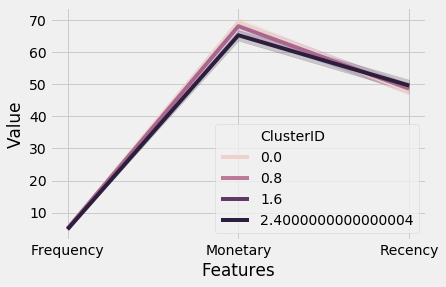

In [39]:
#visualizing with line plots

melted_rfm = pd.melt(RFM_km.reset_index(), 
                    id_vars =  ['ClusterID'],
                    value_vars = ['Recency', 'Frequency', 'Monetary'],
                    var_name = 'Features', 
                    value_name = 'Value')

sns.lineplot('Features', 'Value', hue = 'ClusterID', data = melted_rfm)
plt.legend()

## LRFMP

### Dataset Creation

In [17]:

customer_behavior.head()
rfm_data = customer_behavior[['customer_id_', 'Length', 'Recency', 'order_count_sum', 'grand_total_sum', 
                             'grand_total_mean', 'days_bw_visits']]
rfm_data_noid = rfm_data[['Length', 'Recency', 'order_count_sum', 'grand_total_sum', 'grand_total_mean', 'days_bw_visits']]

rfm_data = customer_behavior[['customer_id_', 'Recency', 'order_count_sum', 'grand_total_sum', 
                             'grand_total_mean', 'days_bw_visits']]
rfm_data_noid = rfm_data[['Recency', 'order_count_sum', 'grand_total_sum', 'grand_total_mean', 'days_bw_visits']]


rfm_data_noid.head()


,Recency,order_count_sum,grand_total_sum,grand_total_mean,days_bw_visits
0,-43.0,2,48.7,24.350000,27.000000
1,-79.0,4,29.6,7.400000,61.333333
2,-30.0,3,37.4,12.466667,69.000000
3,-4.0,6,106.3,17.716667,9.000000
4,-60.0,6,37.2,6.200000,15.800000


### Preprocessing

In [19]:
#drop NAS
rfm_data_noid = rfm_data_noid.dropna()
rfm_data = rfm_data.dropna()
#data pre-processing (normalized)
transformer = Normalizer().fit(rfm_data_noid)
scaled_rfm = transformer.transform(rfm_data_noid)

### Clustering Code

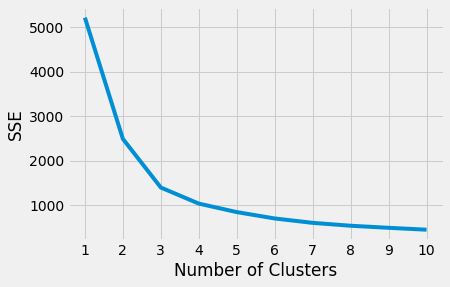

3


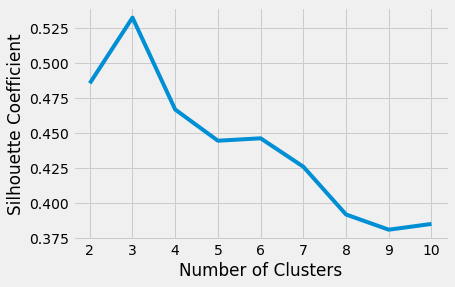

In [20]:
#elbow
kmeans_kwargs = {
    "init": "random",
    "n_init": 10,
    "max_iter": 300,
    "random_state": 42,
}

# A list holds the SSE values for each k
sse = []
for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(scaled_rfm)
    sse.append(kmeans.inertia_)
    
#plot
plt.style.use("fivethirtyeight")
plt.plot(range(1, 11), sse)
plt.xticks(range(1, 11))
plt.xlabel("Number of Clusters")
plt.ylabel("SSE")
plt.show()

#programatically calculating where the elbow point is:
kl = KneeLocator(
    range(1, 11), sse, curve="convex", direction="decreasing"
)

print(kl.elbow)


#silhouette coefficient

# A list holds the silhouette coefficients for each k
silhouette_coefficients = []

# Notice you start at 2 clusters for silhouette coefficient
for k in range(2, 11):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(scaled_rfm)
    score = silhouette_score(scaled_rfm, kmeans.labels_)
    silhouette_coefficients.append(score)
                                   
plt.style.use("fivethirtyeight")
plt.plot(range(2, 11), silhouette_coefficients)
plt.xticks(range(2, 11))
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Coefficient")
plt.show()

In [23]:
print(sse)
print(silhouette_coefficients)

[5217.917670068565, 2492.2615067302213, 1398.4427272914577, 1036.6746734322232, 845.9155311741085, 702.5855357841745, 603.9634761403388, 539.1089515343249, 492.6258193317618, 450.24617114333773]
[0.48561143971945137, 0.5325683666873139, 0.4668249969507217, 0.4445250223570949, 0.44625721704216964, 0.42593793857209794, 0.39174961773572303, 0.38088557957567326, 0.3850178770206788]


### Interp and Vis

In [21]:
#clustering interpretation

#get descriptive stats on each variable
print(rfm_data_noid.describe())

#Dataframe
model_clus4 = KMeans(n_clusters = 3, max_iter=50)
model_clus4.fit(scaled_rfm)
RFM_km = pd.concat([rfm_data, pd.Series(model_clus4.labels_)], axis=1)
RFM_km.columns = ['CustomerID', 'Length', 'Frequency', 'Monetary', 'Monetary_A', 'Periodicity', 'ClusterID']
# RFM_km
# RFM_km.Recency = RFM_km.Recency.dt.days
km_clusters_length = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Length.mean())
# km_clusters_recency = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Recency.mean())
km_clusters_frequency = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Frequency.mean())
km_clusters_monetary = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Monetary.mean())
km_clusters_monetaryav = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Monetary_A.mean())
km_clusters_periodicity = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Periodicity.mean())

km_clusters_count = pd.DataFrame(RFM_km.groupby(["ClusterID"]).count())

print(km_clusters_length)
# print(km_clusters_recency)
print(km_clusters_frequency)
print(km_clusters_monetary)
print(km_clusters_monetaryav)
print(km_clusters_periodicity)

print(km_clusters_count)

            Recency  order_count_sum  grand_total_sum  grand_total_mean  \
count  17526.000000     17526.000000     17526.000000      17526.000000   
mean     -54.600080         7.154171       110.325710         15.067164   
std       60.285566         8.790669       166.768643          8.959487   
min     -271.000000         2.000000         0.000000          0.000000   
25%      -82.000000         2.000000        30.700000          9.378333   
50%      -29.000000         4.000000        59.000000         12.809545   
75%      -10.000000         8.000000       123.400000         18.200000   
max        0.000000       262.000000      3965.500000        114.400000   

       days_bw_visits  
count    17526.000000  
mean        28.413080  
std         33.609061  
min          0.000000  
25%          8.000000  
50%         17.738636  
75%         35.000000  
max        270.000000  
               Length
ClusterID            
0          -21.758133
1          -31.221953
2         -115.04662

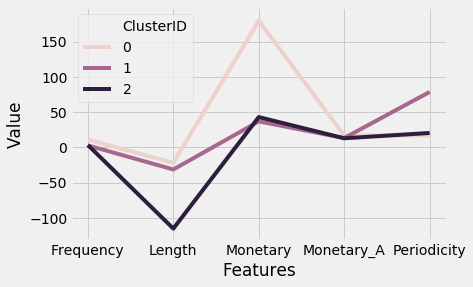

In [22]:
#visualizing with line plots

melted_rfm = pd.melt(RFM_km.reset_index(), 
                    id_vars =  ['CustomerID', 'ClusterID'],
                    value_vars = ['Length', 'Frequency', 'Monetary', 'Monetary_A', 'Periodicity'],
                    var_name = 'Features', 
                    value_name = 'Value')

sns.lineplot('Features', 'Value', hue = 'ClusterID', data = melted_rfm)
plt.legend()

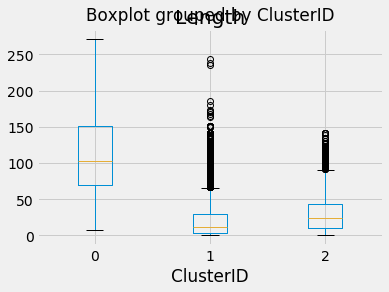

In [173]:
RFM_km.boxplot(column = 'Length', by = 'ClusterID')

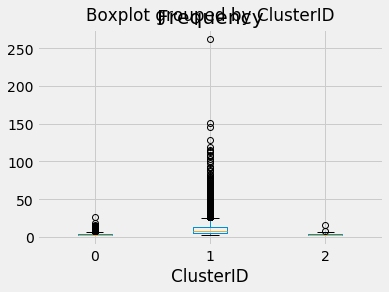

In [174]:
RFM_km.boxplot(column = 'Frequency', by = 'ClusterID')

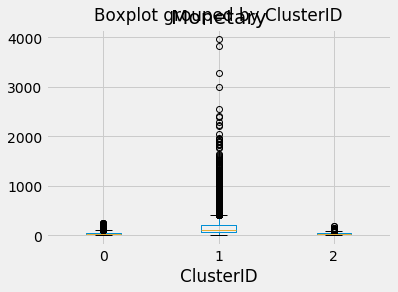

In [175]:
RFM_km.boxplot(column = 'Monetary', by = 'ClusterID')

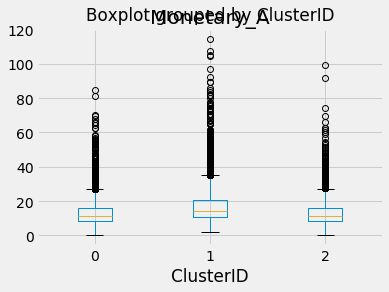

In [176]:
RFM_km.boxplot(column = 'Monetary_A', by = 'ClusterID')

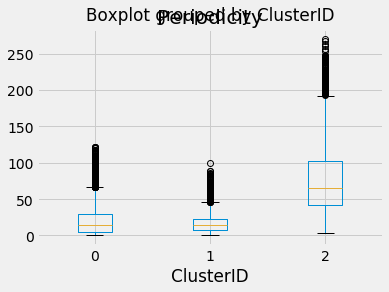

In [177]:
RFM_km.boxplot(column = 'Periodicity', by = 'ClusterID')

               Length  Frequency    Monetary  Monetary_A  Periodicity
ClusterID                                                            
0          115.041341   3.409153   43.105393   13.043042    20.566738
1           21.752882  11.069627  179.604828   16.997605    17.095965
2           31.219605   2.897125   36.950814   13.330130    78.731765
Recency              54.600080
order_count_sum       7.154171
grand_total_sum     110.325710
grand_total_mean     15.067164
days_bw_visits       28.413080
dtype: float64
Length          54.600080
Frequency        7.154171
Monetary       110.325710
Monetary_A      15.067164
Periodicity     28.413080
dtype: float64
             Length  Frequency  Monetary  Monetary_A  Periodicity
ClusterID                                                        
0          1.106981  -0.523473 -0.609290   -0.134340    -0.276152
1         -0.601596   0.547297  0.627951    0.128122    -0.398307
2         -0.428213  -0.595044 -0.665075   -0.115286     1.770969


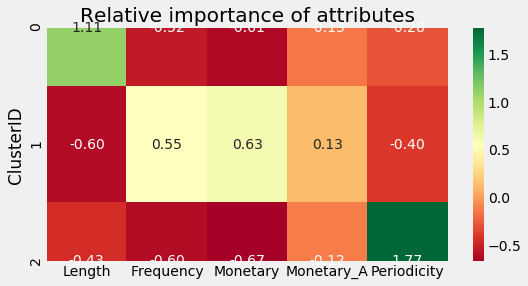

In [178]:
# Calculate average RFM values for each cluster
cluster_avg = RFM_km.groupby(['ClusterID']).mean()
print(cluster_avg)
# Calculate average RFM values for the total customer population
population_avg = rfm_data_noid.mean()
print(population_avg)
population_avg = RFM_km[['Length', 'Frequency', 'Monetary', 'Monetary_A', 'Periodicity']].mean()
print(population_avg)
# Calculate relative importance of cluster's attribute value compared to population
relative_imp = cluster_avg / population_avg - 1
print(relative_imp)
# Initialize a plot with a figure size of 8 by 2 inches 
plt.figure(figsize=(8, 4))
# Add the plot title
plt.title('Relative importance of attributes')
# Plot the heatmap
sns.heatmap(data=relative_imp, annot=True, fmt='.2f', cmap='RdYlGn')
plt.show()

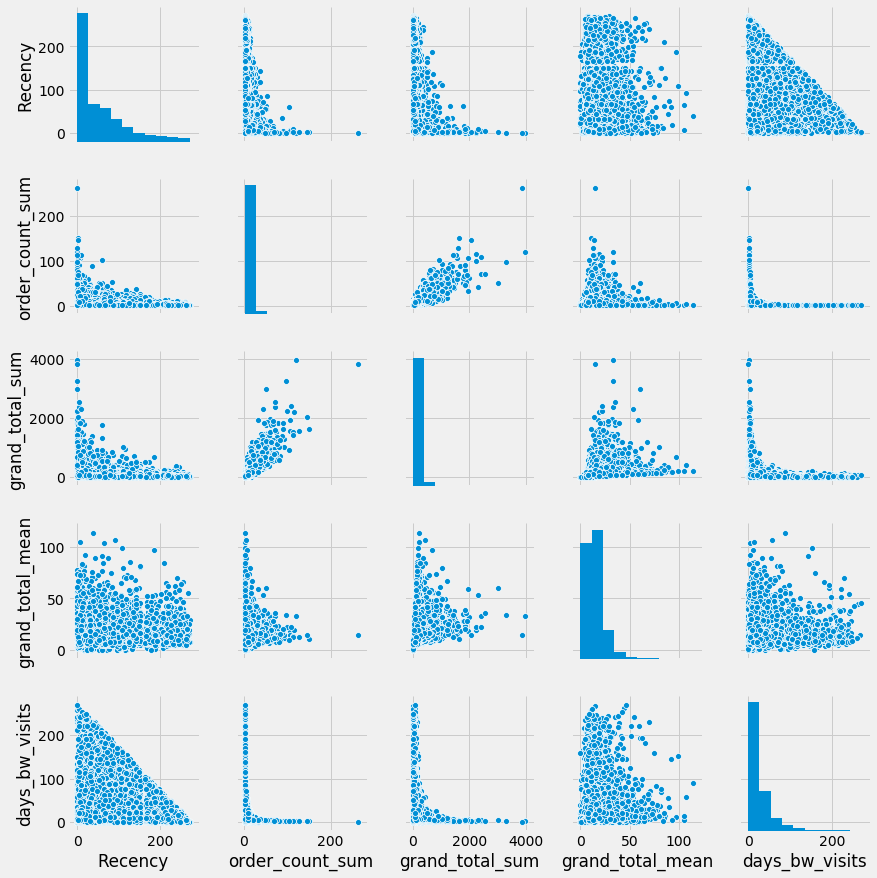

In [179]:
sns.pairplot(rfm_data_noid)

## All Variables

### Dataset Creation

In [27]:

customer_behavior.head()

rfm_data = customer_behavior[['customer_id_', 'Length', 'order_count_sum', 'grand_total_sum', 
                             'grand_total_mean', 'days_bw_visits', 'vendor_id_nunique', 'deliverydistance_mean',
                             'item_count_mean', 'oders_per_location', 'vendor_rating_y_mean', 'delivery_charge_mean',
                             'prepration_time_mean', 'breakfast_r', 'dinner_r', 'late_nigh_r']]
rfm_data_noid = customer_behavior[['Length', 'order_count_sum', 'grand_total_sum', 
                             'grand_total_mean', 'days_bw_visits', 'vendor_id_nunique', 'deliverydistance_mean',
                             'item_count_mean', 'oders_per_location', 'vendor_rating_y_mean', 'delivery_charge_mean',
                             'prepration_time_mean', 'breakfast_r', 'dinner_r', 'late_nigh_r']]

# rfm_data = customer_behavior[['customer_id_', 'order_count_sum', 'grand_total_sum', 
#                               'days_bw_visits', 'vendor_id_nunique',
#                              'item_count_mean', 'delivery_charge_mean',
#                               'breakfast_r', 'dinner_r']]
# rfm_data_noid = customer_behavior[[ 'order_count_sum', 'grand_total_sum', 
#                               'days_bw_visits', 'vendor_id_nunique',
#                              'item_count_mean', 'delivery_charge_mean',
#                               'breakfast_r', 'dinner_r']]

rfm_data_noid.head()

,Length,order_count_sum,grand_total_sum,grand_total_mean,days_bw_visits,vendor_id_nunique,deliverydistance_mean,item_count_mean,oders_per_location,vendor_rating_y_mean,delivery_charge_mean,prepration_time_mean,breakfast_r,dinner_r,late_nigh_r
0,17.510949,2,48.7,24.350000,27.000000,1,6.630000,4.5,2.0,4.60,0.700000,15.000000,0.0,0.500000,0.500000
1,522.083785,4,29.6,7.400000,61.333333,4,1.995000,1.5,1.0,4.20,0.525000,15.500000,0.0,0.000000,1.000000
2,131.085984,3,37.4,12.466667,69.000000,3,0.646667,1.0,1.0,4.30,0.233333,11.666667,0.0,0.000000,0.333333
3,38.151505,6,106.3,17.716667,9.000000,3,6.400000,2.0,2.0,4.70,0.000000,15.500000,0.0,0.500000,0.166667
4,363.935405,6,37.2,6.200000,15.800000,6,1.726667,1.2,1.0,4.15,0.233333,13.166667,0.0,0.333333,0.500000


### Preprocessing

In [28]:
#drop NAS
rfm_data_noid = rfm_data_noid.dropna()
rfm_data = rfm_data.dropna()
#data pre-processing (normalized)
transformer = Normalizer().fit(rfm_data_noid)
scaled_rfm = transformer.transform(rfm_data_noid)

### Clustering Code

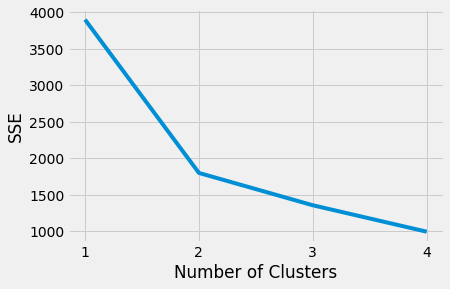

2


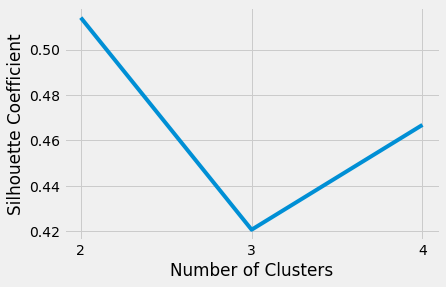

In [29]:
#elbow
kmeans_kwargs = {
    "init": "random",
    "n_init": 10,
    "max_iter": 300,
    "random_state": 42,
}

# A list holds the SSE values for each k
sse = []
for k in range(1, 5):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(scaled_rfm)
    sse.append(kmeans.inertia_)
    
#plot
plt.style.use("fivethirtyeight")
plt.plot(range(1, 5), sse)
plt.xticks(range(1,5))
plt.xlabel("Number of Clusters")
plt.ylabel("SSE")
plt.show()

#programatically calculating where the elbow point is:
kl = KneeLocator(
    range(1, 5), sse, curve="convex", direction="decreasing"
)

print(kl.elbow)


#silhouette coefficient

# A list holds the silhouette coefficients for each k
silhouette_coefficients = []

# Notice you start at 2 clusters for silhouette coefficient
for k in range(2, 5):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(scaled_rfm)
    score = silhouette_score(scaled_rfm, kmeans.labels_)
    silhouette_coefficients.append(score)
                                   
plt.style.use("fivethirtyeight")
plt.plot(range(2, 5), silhouette_coefficients)
plt.xticks(range(2, 5))
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Coefficient")
plt.show()

### Interp and Viz

In [32]:
print(sse)
print(silhouette_coefficients)

[3897.6379461123825, 1799.8653561116448, 1357.567561286704, 995.9863155409264]
[0.5141260399252554, 0.4206835742885785, 0.46686402665116905]


In [39]:
#clustering interpretation

#get descriptive stats on each variable
print(rfm_data_noid.describe())

#Dataframe
model_clus4 = KMeans(n_clusters = 4, max_iter=50)
model_clus4.fit(scaled_rfm)
RFM_km = pd.concat([rfm_data, pd.Series(model_clus4.labels_)], axis=1)

# rfm_data_noid = customer_behavior[['Length', 'Recency', 'order_count_sum', 'grand_total_sum', 
#                              'grand_total_mean', 'days_bw_visits', 'vendor_id_nunique', 'deliverydistance_mean',
#                              'item_count_mean', 'oders_per_location', 'vendor_rating_y_mean', 'delivery_charge_mean',
#                              'prepration_time_mean', 'breakfast_r', 'lunch_r', 'dinner_r', 'late_nigh_r']]
# rfm_data_noid = customer_behavior[['Length', 'order_count_sum', 'grand_total_sum', 
#                              'grand_total_mean', 'days_bw_visits', 'vendor_id_nunique', 'deliverydistance_mean',
#                              'item_count_mean', 'oders_per_location', 'vendor_rating_y_mean', 'delivery_charge_mean',
#                              'prepration_time_mean', 'breakfast_r', 'dinner_r', 'late_nigh_r']]
RFM_km.columns = [ 'Length', 'order_count_sum', 'grand_total_sum', 
                             'grand_total_mean', 'days_bw_visits', 'vendor_id_nunique', 'deliverydistance_mean',
                            'item_count_mean', 'oders_per_location', 'vendor_rating_y_mean', 'delivery_charge_mean',
                          'prepration_time_mean', 'breakfast_r', 'lunch_r', 'dinner_r', 'late_nigh_r', 'ClusterID']
# # RFM_km
# # RFM_km.Recency = RFM_km.Recency.dt.days
# km_clusters_length = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Length.mean())
# # km_clusters_recency = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Recency.mean())
# km_clusters_frequency = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Frequency.mean())
# km_clusters_monetary = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Monetary.mean())
# km_clusters_monetaryav = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Monetary_A.mean())
# km_clusters_periodicity = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Periodicity.mean())
# km_clusters_num_vendors = pd.DataFrame(RFM_km.groupby(["ClusterID"]).vendor_id_nunique.mean())
# km_clusters_delivdist = pd.DataFrame(RFM_km.groupby(["ClusterID"]).deliverydistance_mean.mean())
# km_clusters_itemcounta = pd.DataFrame(RFM_km.groupby(["ClusterID"]).item_count_mean.mean())
# km_clusters_ordersperloc = pd.DataFrame(RFM_km.groupby(["ClusterID"]).oders_per_location.mean())
# km_clusters_vendrating = pd.DataFrame(RFM_km.groupby(["ClusterID"]).vendor_rating_y_mean.mean())
# km_clusters_venddelivcharge = pd.DataFrame(RFM_km.groupby(["ClusterID"]).delivery_charge_mean.mean())
# km_clusters_preptime = pd.DataFrame(RFM_km.groupby(["ClusterID"]).prepration_time_mean.mean())
# km_clusters_breakfast = pd.DataFrame(RFM_km.groupby(["ClusterID"]).breakfast_r.mean())
# # km_clusters_lunch = pd.DataFrame(RFM_km.groupby(["ClusterID"]).lunch_r.mean())
# km_clusters_dinner = pd.DataFrame(RFM_km.groupby(["ClusterID"]).dinner_r.mean())
# km_clusters_latenight = pd.DataFrame(RFM_km.groupby(["ClusterID"]).late_nigh_r.mean())

km_clusters_count = pd.DataFrame(RFM_km.groupby(["ClusterID"]).count())

# print(km_clusters_length)
# # print(km_clusters_recency)
# print(km_clusters_frequency)
# print(km_clusters_monetary)
# print(km_clusters_monetaryav)
# print(km_clusters_periodicity)
# print(km_clusters_num_vendors)
# print(km_clusters_delivdist)


print(km_clusters_count)

             Length  order_count_sum  grand_total_sum  grand_total_mean  \
count  17053.000000     17053.000000     17053.000000      17053.000000   
mean     234.477341         7.168533       110.479875         15.055112   
std      176.079069         8.775839       166.544241          8.952973   
min        0.000000         2.000000         0.000000          0.000000   
25%       71.090903         2.000000        30.700000          9.376923   
50%      213.246806         4.000000        59.200000         12.800000   
75%      389.060764         8.000000       123.800000         18.160000   
max      738.496736       262.000000      3965.500000        114.400000   

       days_bw_visits  vendor_id_nunique  deliverydistance_mean  \
count    17053.000000       17053.000000           17053.000000   
mean        28.464069           3.521844               4.185069   
std         33.605837           2.768569               3.273302   
min          0.000000           1.000000               0

In [40]:
#visualizing with line plots

melted_rfm = pd.melt(RFM_km.reset_index(), 
                    id_vars =  ['customer_id_', 'ClusterID'],
                    value_vars =  [ 'order_count_sum', 'grand_total_sum', 
                              'days_bw_visits', 'vendor_id_nunique',
                             'item_count_mean', 'delivery_charge_mean',
                              'breakfast_r', 'dinner_r'],
                    var_name = 'Features', 
                    value_name = 'Value')

sns.lineplot('Features', 'Value', hue = 'ClusterID', data = melted_rfm)
plt.legend()

KeyError: "The following 'id_vars' are not present in the DataFrame: ['customer_id_']"

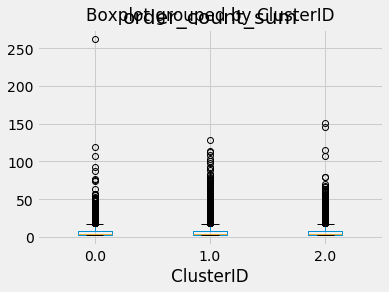

In [164]:
RFM_km.boxplot(column = 'order_count_sum', by = 'ClusterID')

           order_count_sum  grand_total_sum  days_bw_visits  \
ClusterID                                                     
0.0               7.151710       108.718794       28.893040   
1.0               7.175305       110.901793       28.307177   
2.0               7.103109       110.033288       28.345907   

           vendor_id_nunique  item_count_mean  delivery_charge_mean  \
ClusterID                                                             
0.0                 3.468676         2.389782              0.328386   
1.0                 3.538530         2.401175              0.332774   
2.0                 3.480110         2.425451              0.331251   

           breakfast_r  dinner_r  
ClusterID                         
0.0           0.032864  0.292784  
1.0           0.030053  0.288903  
2.0           0.029764  0.286673  
order_count_sum           7.168641
grand_total_sum         110.550535
days_bw_visits           28.491596
vendor_id_nunique         3.518283
item_count_me

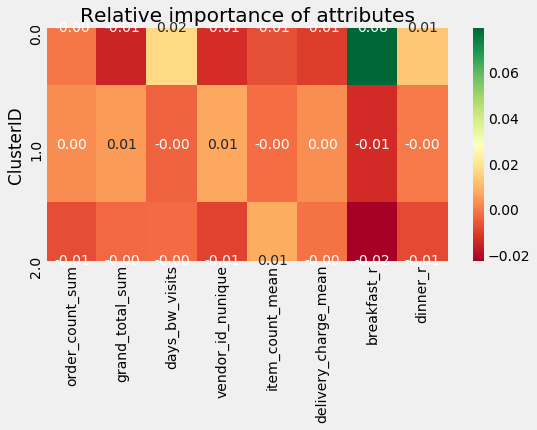

In [165]:
# Calculate average RFM values for each cluster
cluster_avg = RFM_km.groupby(['ClusterID']).mean()
print(cluster_avg)
# Calculate average RFM values for the total customer population
population_avg = rfm_data_noid.mean()
print(population_avg)
population_avg = RFM_km[[ 'order_count_sum', 'grand_total_sum', 
                              'days_bw_visits', 'vendor_id_nunique',
                             'item_count_mean', 'delivery_charge_mean',
                              'breakfast_r', 'dinner_r']].mean()
print(population_avg)
# Calculate relative importance of cluster's attribute value compared to population
relative_imp = cluster_avg / population_avg - 1
print(relative_imp)
# Initialize a plot with a figure size of 8 by 2 inches 
plt.figure(figsize=(8, 4))
# Add the plot title
plt.title('Relative importance of attributes')
# Plot the heatmap
sns.heatmap(data=relative_imp, annot=True, fmt='.2f', cmap='RdYlGn')
plt.show()

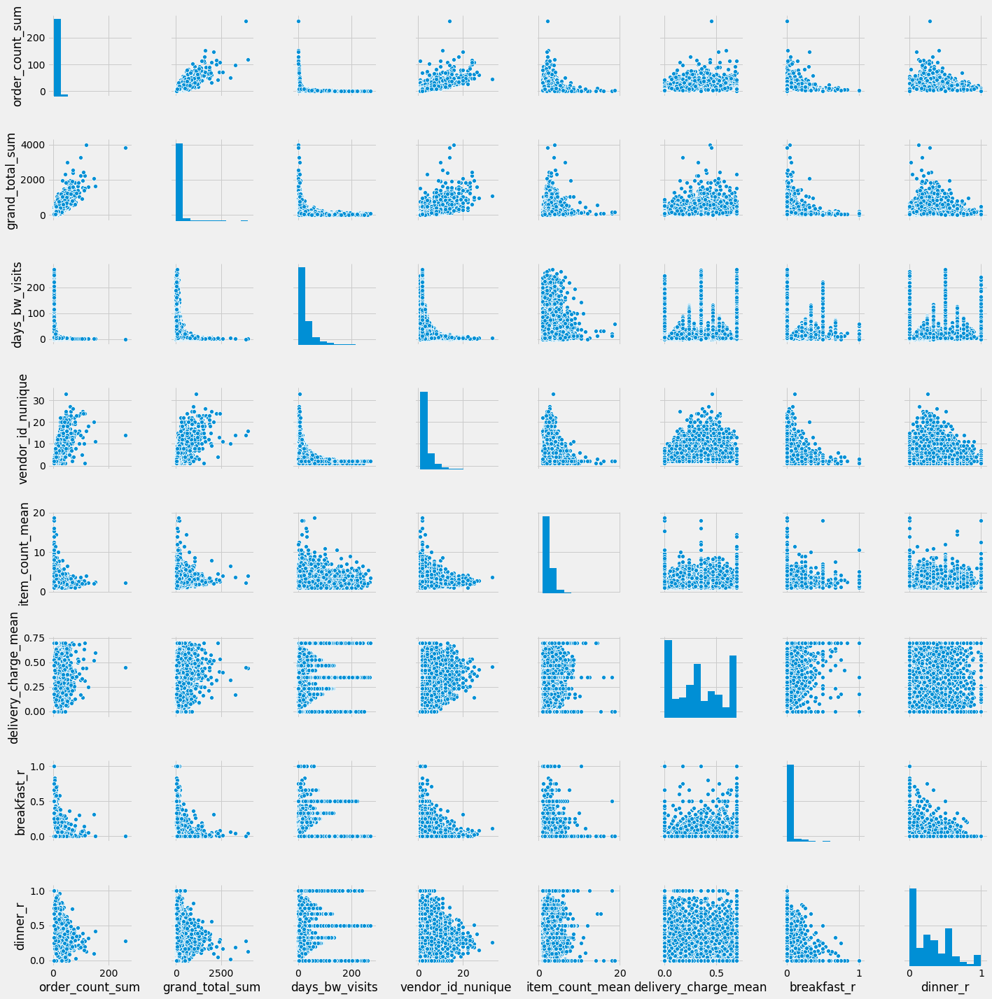

In [166]:
sns.pairplot(rfm_data_noid)

## Variable Selection

### Correlations

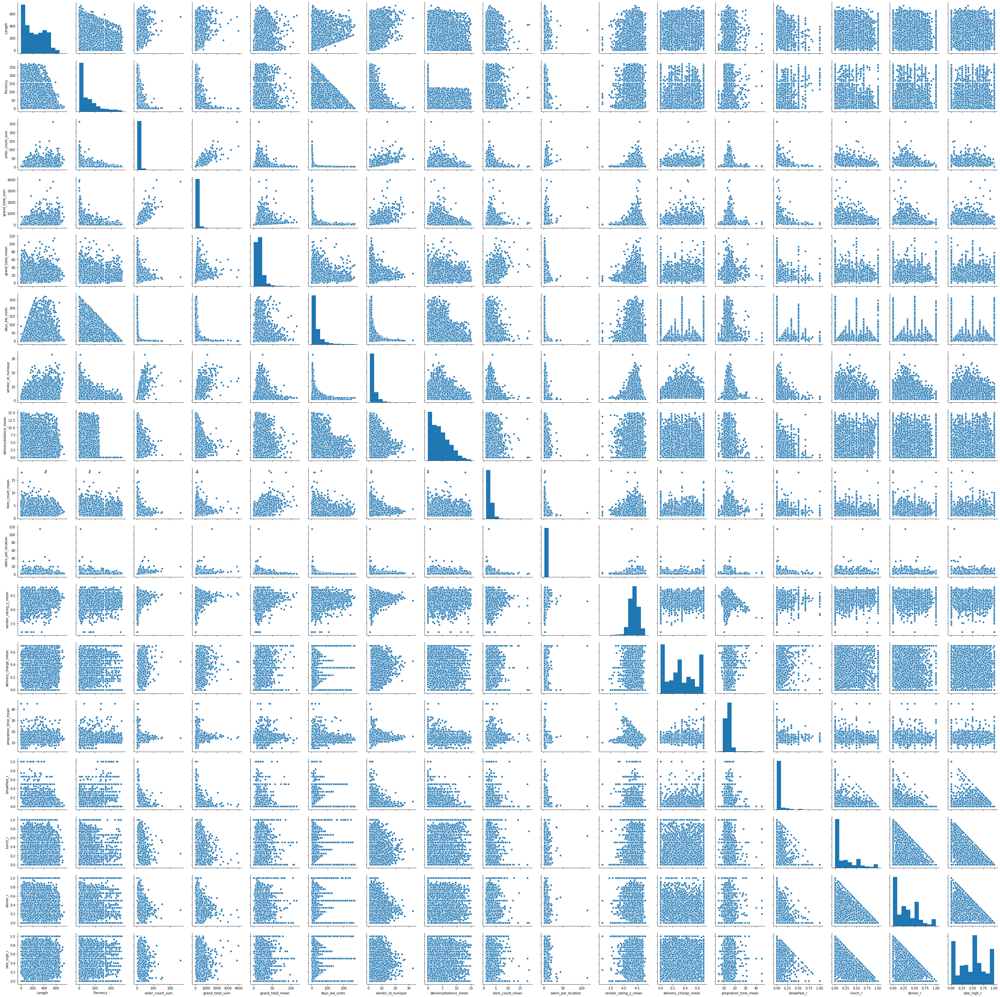

In [11]:
#look for cross correlation first
customer_behavior.head()
customer_behavior['Recency'] = customer_behavior['Recency'].abs()
rfm_data_noid = customer_behavior[['Length', 'Recency', 'order_count_sum', 'grand_total_sum', 
                             'grand_total_mean', 'days_bw_visits', 'vendor_id_nunique', 'deliverydistance_mean',
                             'item_count_mean', 'oders_per_location', 'vendor_rating_y_mean', 'delivery_charge_mean',
                             'prepration_time_mean', 'breakfast_r', 'lunch_r', 'dinner_r', 'late_nigh_r']]
rfm_data_noid = rfm_data_noid.dropna()

sns.pairplot(rfm_data_noid)

In [12]:
rfm_data_noid.corr()

,Length,Recency,order_count_sum,grand_total_sum,grand_total_mean,days_bw_visits,vendor_id_nunique,deliverydistance_mean,item_count_mean,oders_per_location,vendor_rating_y_mean,delivery_charge_mean,prepration_time_mean,breakfast_r,lunch_r,dinner_r,late_nigh_r
Length,1.000000,-0.226261,0.314320,0.299512,0.099574,0.157889,0.404829,-0.061412,0.063052,0.021517,0.057110,0.012313,0.095662,0.017823,-0.026623,-0.020541,0.034257
Recency,-0.226261,1.000000,-0.251564,-0.206614,0.021262,-0.029164,-0.273864,-0.478078,0.085592,-0.097005,0.000657,0.182667,0.222956,0.199263,-0.118346,-0.049366,0.080198
order_count_sum,0.314320,-0.251564,1.000000,0.854996,0.032544,-0.249672,0.756339,-0.019272,0.000251,0.445665,0.082442,0.026772,0.079128,0.013944,0.044827,0.006865,-0.047732
grand_total_sum,0.299512,-0.206614,0.854996,1.000000,0.349691,-0.191158,0.682029,-0.037686,0.211517,0.325042,0.111822,0.056258,0.110817,0.007159,0.052386,-0.000823,-0.045526
grand_total_mean,0.099574,0.021262,0.032544,0.349691,1.000000,0.078070,0.069408,-0.031968,0.650334,-0.037206,0.128387,0.081553,0.114298,-0.001933,0.036939,-0.003871,-0.027191
days_bw_visits,0.157889,-0.029164,-0.249672,-0.191158,0.078070,1.000000,-0.190718,-0.140757,0.082290,-0.212643,0.012041,0.038825,0.048192,0.055318,-0.051260,-0.024205,0.046592
vendor_id_nunique,0.404829,-0.273864,0.756339,0.682029,0.069408,-0.190718,1.000000,-0.013523,0.038226,-0.011754,0.005451,0.048602,0.101071,0.004887,0.043584,0.007859,-0.044756
deliverydistance_mean,-0.061412,-0.478078,-0.019272,-0.037686,-0.031968,-0.140757,-0.013523,1.000000,-0.062151,-0.013270,0.029709,-0.132166,-0.134379,-0.211280,0.149437,0.068744,-0.119004
item_count_mean,0.063052,0.085592,0.000251,0.211517,0.650334,0.082290,0.038226,-0.062151,1.000000,-0.052935,0.025807,0.141683,0.112655,0.038108,-0.017127,-0.046799,0.042224
oders_per_location,0.021517,-0.097005,0.445665,0.325042,-0.037206,-0.212643,-0.011754,-0.013270,-0.052935,1.000000,0.111611,-0.017682,0.010893,0.004278,0.028857,0.002911,-0.028019


In [26]:
#remove cross correlated variables

#just order count sum

rfm_data_noid = customer_behavior[['Length', 'Recency', 'grand_total_sum', 
                             'grand_total_mean', 'days_bw_visits', 'vendor_id_nunique', 'deliverydistance_mean',
                             'item_count_mean', 'oders_per_location', 'vendor_rating_y_mean', 'delivery_charge_mean',
                             'prepration_time_mean', 'breakfast_r', 'lunch_r', 'dinner_r', 'late_nigh_r']]
rfm_data = customer_behavior[['customer_id_', 'Length', 'Recency', 'grand_total_sum', 
                             'grand_total_mean', 'days_bw_visits', 'vendor_id_nunique', 'deliverydistance_mean',
                             'item_count_mean', 'oders_per_location', 'vendor_rating_y_mean', 'delivery_charge_mean',
                             'prepration_time_mean', 'breakfast_r', 'lunch_r', 'dinner_r', 'late_nigh_r']]


### Clustering without Correlated Variables

#### Preprocessing

In [27]:
#drop NAS
rfm_data_noid = rfm_data_noid.dropna()
rfm_data = rfm_data.dropna()

#data pre-processing (normalized)
transformer = Normalizer().fit(rfm_data_noid)
scaled_rfm = transformer.transform(rfm_data_noid)

#### Clustering Code

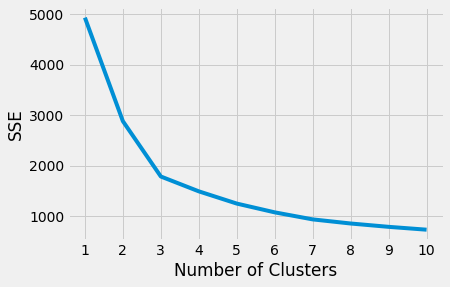

3


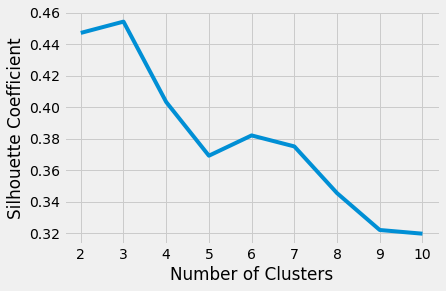

In [28]:
#elbow
kmeans_kwargs = {
    "init": "random",
    "n_init": 10,
    "max_iter": 300,
    "random_state": 42,
}

# A list holds the SSE values for each k
sse = []
for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(scaled_rfm)
    sse.append(kmeans.inertia_)
    
#plot
plt.style.use("fivethirtyeight")
plt.plot(range(1, 11), sse)
plt.xticks(range(1, 11))
plt.xlabel("Number of Clusters")
plt.ylabel("SSE")
plt.show()

#programatically calculating where the elbow point is:
kl = KneeLocator(
    range(1, 11), sse, curve="convex", direction="decreasing"
)

print(kl.elbow)


#silhouette coefficient

# A list holds the silhouette coefficients for each k
silhouette_coefficients = []

# Notice you start at 2 clusters for silhouette coefficient
for k in range(2, 11):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(scaled_rfm)
    score = silhouette_score(scaled_rfm, kmeans.labels_)
    silhouette_coefficients.append(score)
                                   
plt.style.use("fivethirtyeight")
plt.plot(range(2, 11), silhouette_coefficients)
plt.xticks(range(2, 11))
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Coefficient")
plt.show()

#### INterp and Vis

In [32]:
#clustering interpretation

#get descriptive stats on each variable
print(rfm_data_noid.describe())

#Dataframe
model_clus4 = KMeans(n_clusters = 3, max_iter=50)
model_clus4.fit(scaled_rfm)
RFM_km = pd.concat([rfm_data_noid, pd.Series(model_clus4.labels_)], axis=1)
RFM_km.columns = [ 'Length', 'Recency', 'grand_total_sum', 
                             'grand_total_mean', 'days_bw_visits', 'vendor_id_nunique', 'deliverydistance_mean',
                             'item_count_mean', 'oders_per_location', 'vendor_rating_y_mean', 'delivery_charge_mean',
                             'prepration_time_mean', 'breakfast_r', 'lunch_r', 'dinner_r', 'late_nigh_r', 'ClusterID']

# # RFM_km
# # RFM_km.Recency = RFM_km.Recency.dt.days
# km_clusters_length = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Length.mean())
# # km_clusters_recency = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Recency.mean())
# km_clusters_frequency = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Frequency.mean())
# km_clusters_monetary = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Monetary.mean())
# km_clusters_monetaryav = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Monetary_A.mean())
# km_clusters_periodicity = pd.DataFrame(RFM_km.groupby(["ClusterID"]).Periodicity.mean())

km_clusters_count = pd.DataFrame(RFM_km.groupby(["ClusterID"]).count())
km_clusters_mean = pd.DataFrame(RFM_km.groupby(["ClusterID"]).mean())

# print(km_clusters_length)
# # print(km_clusters_recency)
# print(km_clusters_frequency)
# print(km_clusters_monetary)
# print(km_clusters_monetaryav)
# print(km_clusters_periodicity)

print(km_clusters_count)

             Length       Recency  grand_total_sum  grand_total_mean  \
count  17053.000000  17053.000000     17053.000000      17053.000000   
mean     234.477341     54.325280       110.479875         15.055112   
std      176.079069     60.216713       166.544241          8.952973   
min        0.000000      0.000000         0.000000          0.000000   
25%       71.090903      9.000000        30.700000          9.376923   
50%      213.246806     29.000000        59.200000         12.800000   
75%      389.060764     81.000000       123.800000         18.160000   
max      738.496736    271.000000      3965.500000        114.400000   

       days_bw_visits  vendor_id_nunique  deliverydistance_mean  \
count    17053.000000       17053.000000           17053.000000   
mean        28.464069           3.521844               4.185069   
std         33.605837           2.768569               3.273302   
min          0.000000           1.000000               0.000000   
25%          8.1

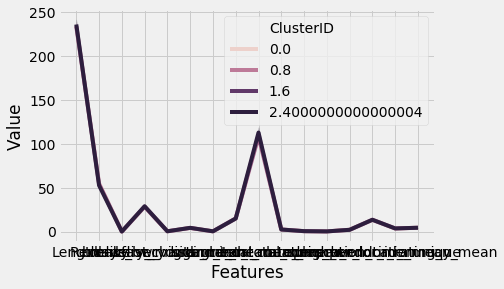

In [33]:
#visualizing with line plots

melted_rfm = pd.melt(RFM_km.reset_index(), 
                    id_vars =  ['ClusterID'],
                    value_vars = ['Length', 'Recency', 'grand_total_sum', 
                             'grand_total_mean', 'days_bw_visits', 'vendor_id_nunique', 'deliverydistance_mean',
                             'item_count_mean', 'oders_per_location', 'vendor_rating_y_mean', 'delivery_charge_mean',
                             'prepration_time_mean', 'breakfast_r', 'lunch_r', 'dinner_r', 'late_nigh_r'],
                    var_name = 'Features', 
                    value_name = 'Value')

sns.lineplot('Features', 'Value', hue = 'ClusterID', data = melted_rfm)
plt.legend()

               Length    Recency  grand_total_sum  grand_total_mean  \
ClusterID                                                             
0.0        234.407417  54.729887       110.331124         15.115047   
1.0        234.130483  54.577984       108.594935         14.998761   
2.0        236.205147  52.671751       112.959136         14.929517   

           days_bw_visits  vendor_id_nunique  deliverydistance_mean  \
ClusterID                                                             
0.0             28.316286           3.484195               4.151031   
1.0             28.432898           3.560933               4.173332   
2.0             28.919181           3.592946               4.274778   

           item_count_mean  oders_per_location  vendor_rating_y_mean  \
ClusterID                                                              
0.0               2.413902            2.074157              4.378406   
1.0               2.393242            2.027175              4.379932   


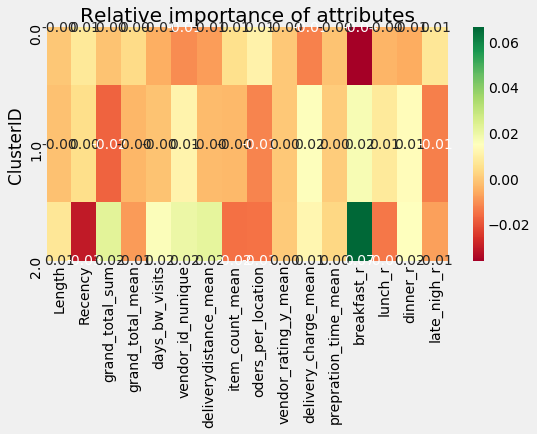

In [34]:
# Calculate average RFM values for each cluster
cluster_avg = RFM_km.groupby(['ClusterID']).mean()
print(cluster_avg)
# Calculate average RFM values for the total customer population
population_avg = rfm_data_noid.mean()
print(population_avg)
population_avg = RFM_km[['Length', 'Recency', 'grand_total_sum', 
                             'grand_total_mean', 'days_bw_visits', 'vendor_id_nunique', 'deliverydistance_mean',
                             'item_count_mean', 'oders_per_location', 'vendor_rating_y_mean', 'delivery_charge_mean',
                             'prepration_time_mean', 'breakfast_r', 'lunch_r', 'dinner_r', 'late_nigh_r']].mean()
print(population_avg)
# Calculate relative importance of cluster's attribute value compared to population
relative_imp = cluster_avg / population_avg - 1
print(relative_imp)
# Initialize a plot with a figure size of 8 by 2 inches 
plt.figure(figsize=(8, 4))
# Add the plot title
plt.title('Relative importance of attributes')
# Plot the heatmap
sns.heatmap(data=relative_imp, annot=True, fmt='.2f', cmap='RdYlGn')
plt.show()

### Stepwise

In [ ]:
#empty set (sf)
    #sf = 
#perform k-means on features selected, initially empty

# rfm_data_noid = customer_behavior[['Length', 'Recency', 'order_count_sum', 'grand_total_sum', 
#                              'grand_total_mean', 'days_bw_visits', 'vendor_id_nunique', 'deliverydistance_mean',
#                              'item_count_mean', 'oders_per_location', 'vendor_rating_y_mean', 'delivery_charge_mean',
#                              'prepration_time_mean', 'breakfast_r', 'lunch_r', 'dinner_r', 'late_nigh_r']]
# rfm_data_noid = rfm_data_noid.dropna()

#take feature which gives the best Sillhouette Score & add it to SF

rfm_data_noid = customer_behavior[['grand_total_sum', 'breakfast_r', 'Length']]
rfm_data_noid = rfm_data_noid.dropna()
#data pre-processing (normalized)
transformer = Normalizer().fit(rfm_data_noid)
scaled_rfm = transformer.transform(rfm_data_noid)
#cluster
kmeans = KMeans(
    init="random",
    n_clusters=3,
    n_init=10,
    max_iter=300,
    random_state=42
)
print(kmeans.fit(scaled_rfm))
print('lowest SSE value', kmeans.inertia_)
score = silhouette_score(scaled_rfm, kmeans.labels_)
print(score)

#perform k-means on sf and each of the remaining variables individually
#take the feature which gives the best performance and add it to SF
#repeat until score is optimized

KMeans(algorithm='auto', copy_x=True, init='random', max_iter=300, n_clusters=3,
       n_init=10, n_jobs=None, precompute_distances='auto', random_state=42,
       tol=0.0001, verbose=0)
lowest SSE value 383.0256415436502


In [ ]:
rfm_data_noid = customer_behavior[['grand_total_sum', 'breakfast_r', 'Recency']]
rfm_data_noid = rfm_data_noid.dropna()
#data pre-processing (normalized)
transformer = Normalizer().fit(rfm_data_noid)
scaled_rfm = transformer.transform(rfm_data_noid)
#cluster
kmeans = KMeans(
    init="random",
    n_clusters=3,
    n_init=10,
    max_iter=300,
    random_state=42
)
print(kmeans.fit(scaled_rfm))
print('lowest SSE value', kmeans.inertia_)
score = silhouette_score(scaled_rfm, kmeans.labels_)
print(score)

In [ ]:
rfm_data_noid = customer_behavior[['grand_total_sum', 'breakfast_r', 'order_count_sum']]
rfm_data_noid = rfm_data_noid.dropna()
#data pre-processing (normalized)
transformer = Normalizer().fit(rfm_data_noid)
scaled_rfm = transformer.transform(rfm_data_noid)
#cluster
kmeans = KMeans(
    init="random",
    n_clusters=3,
    n_init=10,
    max_iter=300,
    random_state=42
)
print(kmeans.fit(scaled_rfm))
print('lowest SSE value', kmeans.inertia_)
score = silhouette_score(scaled_rfm, kmeans.labels_)
print(score)

In [ ]:
rfm_data_noid = customer_behavior[['grand_total_sum', 'breakfast_r', 'grand_total_mean']]
rfm_data_noid = rfm_data_noid.dropna()
#data pre-processing (normalized)
transformer = Normalizer().fit(rfm_data_noid)
scaled_rfm = transformer.transform(rfm_data_noid)
#cluster
kmeans = KMeans(
    init="random",
    n_clusters=3,
    n_init=10,
    max_iter=300,
    random_state=42
)
print(kmeans.fit(scaled_rfm))
print('lowest SSE value', kmeans.inertia_)
score = silhouette_score(scaled_rfm, kmeans.labels_)
print(score)

In [ ]:
rfm_data_noid = customer_behavior[['grand_total_sum', 'breakfast_r', 'days_bw_visits']]
rfm_data_noid = rfm_data_noid.dropna()
#data pre-processing (normalized)
transformer = Normalizer().fit(rfm_data_noid)
scaled_rfm = transformer.transform(rfm_data_noid)
#cluster
kmeans = KMeans(
    init="random",
    n_clusters=3,
    n_init=10,
    max_iter=300,
    random_state=42
)
print(kmeans.fit(scaled_rfm))
print('lowest SSE value', kmeans.inertia_)
score = silhouette_score(scaled_rfm, kmeans.labels_)
print(score)

### Final Model

In [41]:
#data creation
customer_behavior['Recency'] = customer_behavior['Recency'].abs()
rfm_data = customer_behavior[['customer_id_', 'grand_total_sum', 'breakfast_r', 'lunch_r', 'delivery_charge_mean',
                                   'oders_per_location', 'dinner_r', 'late_nigh_r', 'Recency']]
rfm_data = rfm_data.dropna()

rfm_data_noid = customer_behavior[['grand_total_sum', 'breakfast_r', 'lunch_r', 'delivery_charge_mean',
                                   'oders_per_location', 'dinner_r', 'late_nigh_r', 'Recency']]
rfm_data_noid = rfm_data_noid.dropna()

# rfm_data_noid = customer_behavior[['Length', 'Recency', 'order_count_sum', 'grand_total_sum', 
#                              'grand_total_mean', 'days_bw_visits', 'vendor_id_nunique', 'deliverydistance_mean',
#                              'item_count_mean', 'oders_per_location', 'vendor_rating_y_mean', 'delivery_charge_mean',
#                              'prepration_time_mean', 'breakfast_r', 'lunch_r', 'dinner_r', 'late_nigh_r']]

#data pre-processing (normalized)
transformer = Normalizer().fit(rfm_data_noid)
scaled_rfm = transformer.transform(rfm_data_noid)

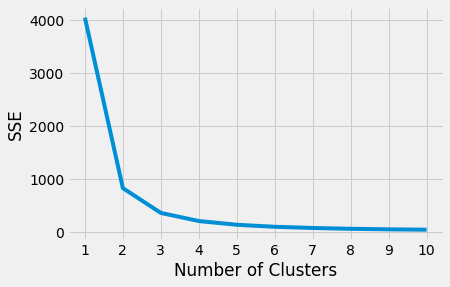

3


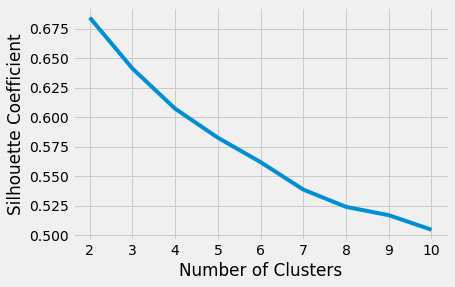

In [42]:
#elbow
kmeans_kwargs = {
    "init": "random",
    "n_init": 10,
    "max_iter": 300,
    "random_state": 42,
}

# A list holds the SSE values for each k
sse = []
for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(scaled_rfm)
    sse.append(kmeans.inertia_)
    
#plot
plt.style.use("fivethirtyeight")
plt.plot(range(1, 11), sse)
plt.xticks(range(1, 11))
plt.xlabel("Number of Clusters")
plt.ylabel("SSE")
plt.show()

#programatically calculating where the elbow point is:
kl = KneeLocator(
    range(1, 11), sse, curve="convex", direction="decreasing"
)

print(kl.elbow)


#silhouette coefficient

# A list holds the silhouette coefficients for each k
silhouette_coefficients = []

# Notice you start at 2 clusters for silhouette coefficient
for k in range(2, 11):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(scaled_rfm)
    score = silhouette_score(scaled_rfm, kmeans.labels_)
    silhouette_coefficients.append(score)
                                   
plt.style.use("fivethirtyeight")
plt.plot(range(2, 11), silhouette_coefficients)
plt.xticks(range(2, 11))
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Coefficient")
plt.show()

In [43]:
print(sse)
print(silhouette_coefficients)

[4048.9836690108864, 831.055110582707, 362.46903355759616, 209.4954959520521, 138.9315598700251, 100.75652643161384, 78.36422034990348, 63.04953167780914, 52.396406133196294, 45.90889495619485]
[0.684293896593332, 0.641154719711342, 0.6071106981130466, 0.5825617441334279, 0.5618938290033849, 0.5386418339812248, 0.5240167145269771, 0.5169749256380529, 0.5046759794284694]


In [44]:
#clustering interpretation

#get descriptive stats on each variable
print(rfm_data_noid.describe())

#Dataframe
model_clus4 = KMeans(n_clusters = 3, max_iter=200)
model_clus4.fit(scaled_rfm)
RFM_km = pd.concat([rfm_data, pd.Series(model_clus4.labels_)], axis=1)
RFM_km.head()
RFM_km.columns = ['CustomerID', 'grand_total_sum', 'breakfast_r', 'lunch_r', 'delivery_charge_mean',
                                   'oders_per_location', 'dinner_r', 'late_nigh_r', 'Recency',
                                  'ClusterID']


km_clusters_count = pd.DataFrame(RFM_km.groupby(["ClusterID"]).count())
km_clusters_mean = pd.DataFrame(RFM_km.groupby(["ClusterID"]).mean())


print(km_clusters_count)
print(km_clusters_mean)

       grand_total_sum   breakfast_r       lunch_r  delivery_charge_mean  \
count     17526.000000  17526.000000  17526.000000          17526.000000   
mean        110.325710      0.030449      0.200459              0.331717   
std         166.768643      0.100880      0.274939              0.245496   
min           0.000000      0.000000      0.000000              0.000000   
25%          30.700000      0.000000      0.000000              0.116667   
50%          59.000000      0.000000      0.000000              0.350000   
75%         123.400000      0.000000      0.333333              0.525000   
max        3965.500000      1.000000      1.000000              0.700000   

       oders_per_location      dinner_r   late_nigh_r       Recency  
count        17526.000000  17526.000000  17526.000000  17526.000000  
mean             2.052051      0.288954      0.480138     54.600080  
std              1.786395      0.276069      0.327400     60.285566  
min              1.000000      0.00

In [46]:
RFM_km.head()

,CustomerID,grand_total_sum,breakfast_r,lunch_r,delivery_charge_mean,oders_per_location,dinner_r,late_nigh_r,Recency,ClusterID
0,005ECL6,48.7,0.0,0.000000,0.700000,2.0,0.500000,0.500000,43.0,0
1,009UFS1,29.6,0.0,0.000000,0.525000,1.0,0.000000,1.000000,79.0,1
2,00GV4J4,37.4,0.0,0.666667,0.233333,1.0,0.000000,0.333333,30.0,0
3,00HRRAK,106.3,0.0,0.333333,0.000000,2.0,0.500000,0.166667,4.0,2
4,00HWUU3,37.2,0.0,0.166667,0.233333,1.0,0.333333,0.500000,60.0,1


In [52]:
rfm_km_value = RFM_km[[ 'grand_total_sum', 'breakfast_r', 'lunch_r', 'delivery_charge_mean', 'oders_per_location', 
                'dinner_r', 'late_nigh_r', 'Recency']]
new_rfm = rfm_km_value.apply(lambda x: x/x.max(), axis=0)

rfm_km_notvalue = RFM_km[['CustomerID', 'ClusterID']]

new = pd.concat([rfm_km_notvalue, new_rfm], axis=1)
new.head()

,CustomerID,ClusterID,grand_total_sum,breakfast_r,lunch_r,delivery_charge_mean,oders_per_location,dinner_r,late_nigh_r,Recency
0,005ECL6,0,0.012281,0.0,0.000000,1.000000,0.017544,0.500000,0.500000,0.158672
1,009UFS1,1,0.007464,0.0,0.000000,0.750000,0.008772,0.000000,1.000000,0.291513
2,00GV4J4,0,0.009431,0.0,0.666667,0.333333,0.008772,0.000000,0.333333,0.110701
3,00HRRAK,2,0.026806,0.0,0.333333,0.000000,0.017544,0.500000,0.166667,0.014760
4,00HWUU3,1,0.009381,0.0,0.166667,0.333333,0.008772,0.333333,0.500000,0.221402


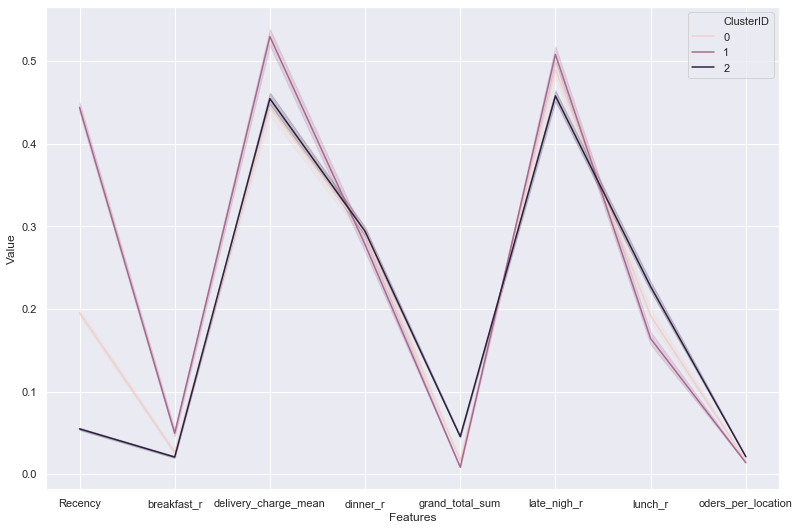

In [53]:
#visualizing with line plots
sns.set(rc={'figure.figsize':(11.7,8.27)})

melted_rfm = pd.melt(new.reset_index(), 
                    id_vars =  ['ClusterID'],
                    value_vars = ['grand_total_sum', 'breakfast_r', 'lunch_r', 'delivery_charge_mean',
                                   'oders_per_location', 'dinner_r', 'late_nigh_r', 'Recency',
                                  ],
                    var_name = 'Features', 
                    value_name = 'Value')

sns.lineplot('Features', 'Value', hue = 'ClusterID', data = melted_rfm)
plt.legend()

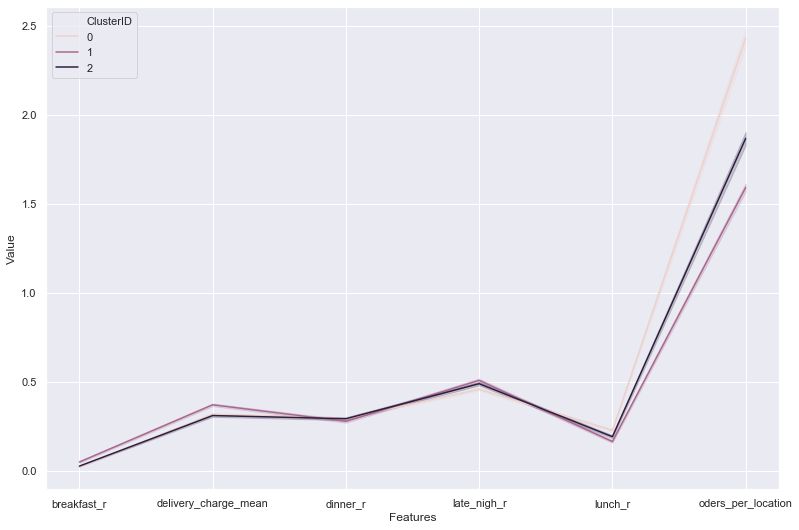

In [11]:
#visualizing with line plots
sns.set(rc={'figure.figsize':(11.7,8.27)})

RFM_km_2 = RFM_km[['breakfast_r', 'lunch_r', 'delivery_charge_mean',
                                   'oders_per_location', 'dinner_r', 'late_nigh_r',
                                  'ClusterID']]

melted_rfm = pd.melt(RFM_km_2.reset_index(), 
                    id_vars =  ['ClusterID'],
                    value_vars = ['breakfast_r', 'lunch_r', 'delivery_charge_mean',
                                   'oders_per_location', 'dinner_r', 'late_nigh_r',
                                  ],
                    var_name = 'Features', 
                    value_name = 'Value')

sns.lineplot('Features', 'Value', hue = 'ClusterID', data = melted_rfm)
plt.legend()

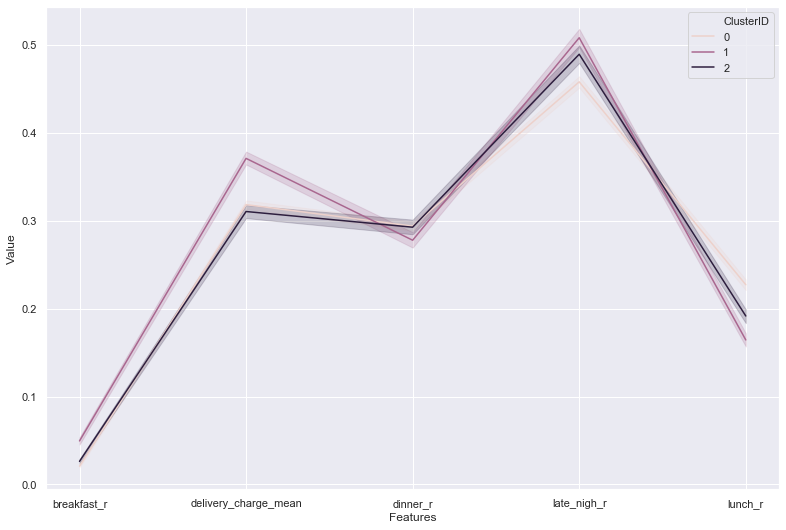

In [12]:
#visualizing with line plots
sns.set(rc={'figure.figsize':(11.7,8.27)})

RFM_km_2 = RFM_km[['breakfast_r', 'lunch_r', 'delivery_charge_mean',
                                  'dinner_r', 'late_nigh_r',
                                  'ClusterID']]

melted_rfm = pd.melt(RFM_km_2.reset_index(), 
                    id_vars =  ['ClusterID'],
                    value_vars = ['breakfast_r', 'lunch_r', 'delivery_charge_mean',
                                  'dinner_r', 'late_nigh_r',
                                  ],
                    var_name = 'Features', 
                    value_name = 'Value')

sns.lineplot('Features', 'Value', hue = 'ClusterID', data = melted_rfm)
plt.legend()

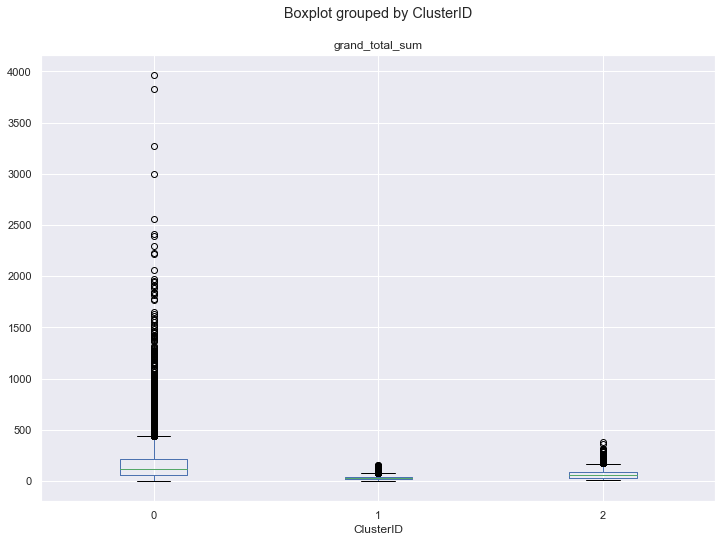

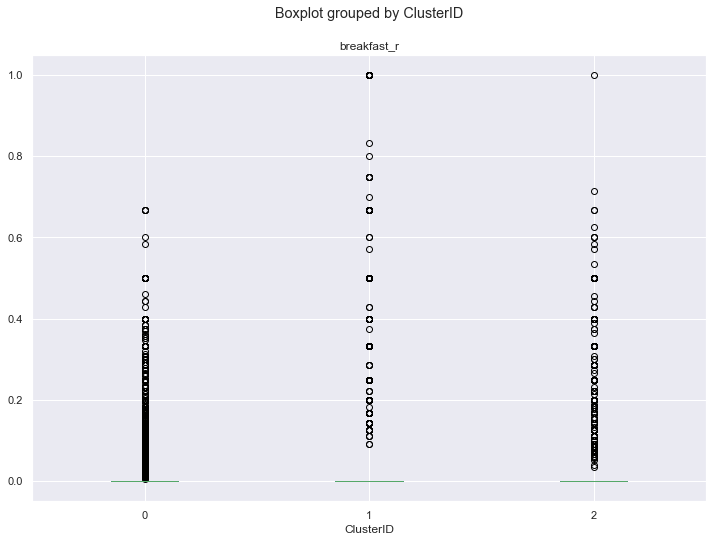

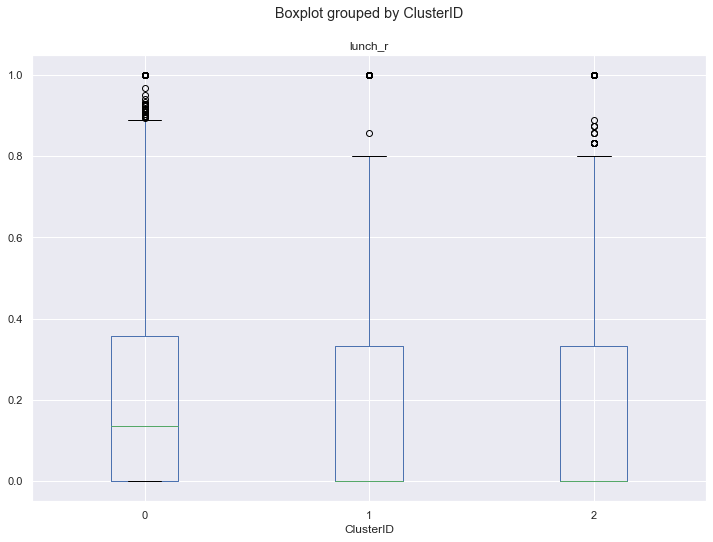

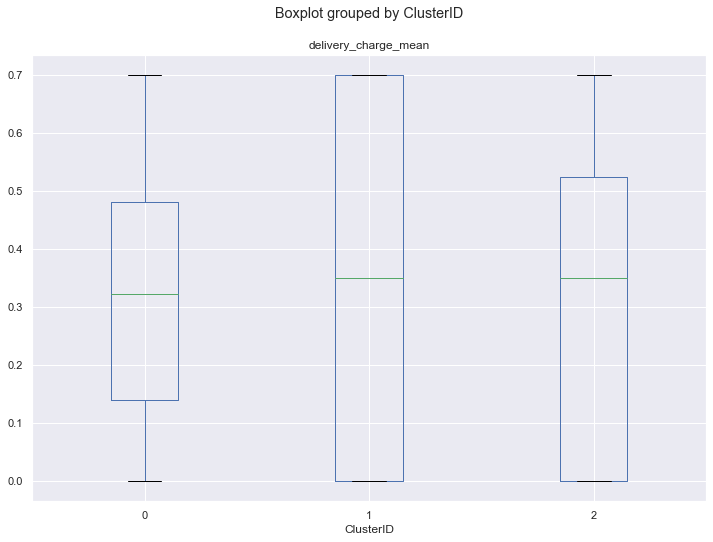

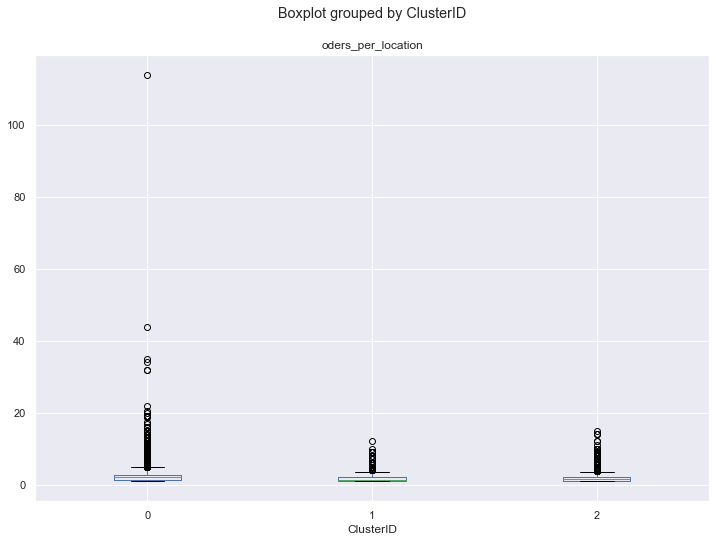

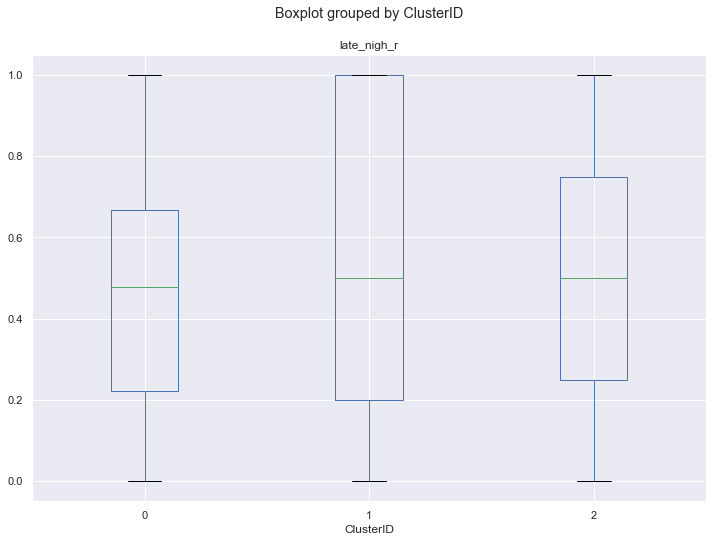

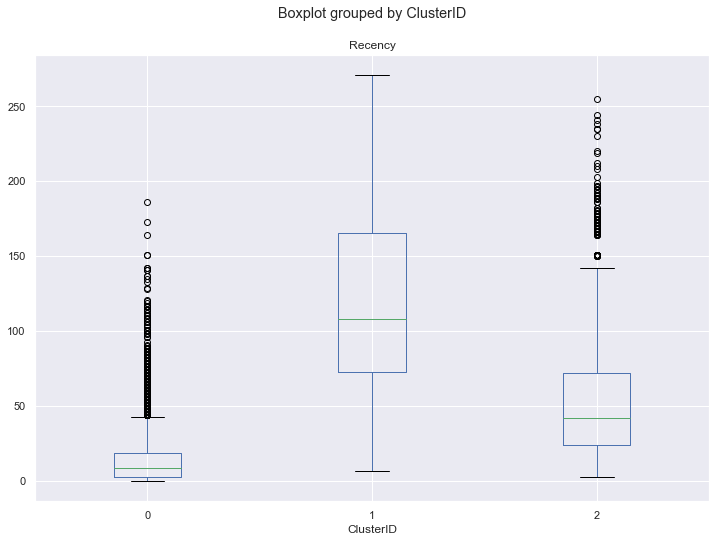

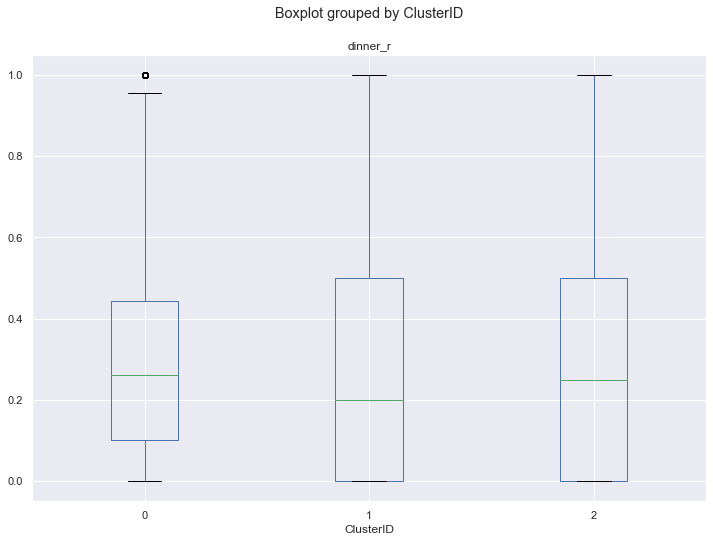

In [13]:

RFM_km.boxplot(column = 'grand_total_sum', by = 'ClusterID')
RFM_km.boxplot(column = 'breakfast_r', by = 'ClusterID')
RFM_km.boxplot(column = 'lunch_r', by = 'ClusterID')
RFM_km.boxplot(column = 'delivery_charge_mean', by = 'ClusterID')
RFM_km.boxplot(column = 'oders_per_location', by = 'ClusterID')
RFM_km.boxplot(column = 'late_nigh_r', by = 'ClusterID')
RFM_km.boxplot(column = 'Recency', by = 'ClusterID')
RFM_km.boxplot(column = 'dinner_r', by = 'ClusterID')

In [14]:
# Calculate average RFM values for each cluster
cluster_avg = RFM_km.groupby(['ClusterID']).mean()
print(cluster_avg)
# Calculate average RFM values for the total customer population
population_avg = rfm_data_noid.mean()
print(population_avg)
population_avg = RFM_km[['grand_total_sum', 'breakfast_r', 'lunch_r', 'delivery_charge_mean',
                                   'oders_per_location', 'dinner_r', 'late_nigh_r', 'Recency', 'late_nigh_r',
                                  ]].mean()
print(population_avg)
# Calculate relative importance of cluster's attribute value compared to population
relative_imp = cluster_avg / population_avg - 1
print(relative_imp)
# Initialize a plot with a figure size of 8 by 2 inches 
plt.figure(figsize=(8, 4))
# Add the plot title
plt.title('Relative importance of attributes')
# Plot the heatmap
sns.heatmap(data=relative_imp, annot=True, fmt='.2f', cmap='RdYlGn')
plt.show()

           grand_total_sum  breakfast_r   lunch_r  delivery_charge_mean  \
ClusterID                                                                 
0               180.518801     0.020792  0.227254              0.318349   
1                33.575074     0.049534  0.164416              0.370947   
2                65.995308     0.026277  0.191659              0.310514   

           oders_per_location  dinner_r  late_nigh_r     Recency  
ClusterID                                                         
0                    2.431231  0.293921     0.458033   14.864891  
1                    1.591684  0.277849     0.508201  120.312414  
2                    1.867700  0.292654     0.489409   52.876540  
grand_total_sum         110.325710
breakfast_r               0.030449
lunch_r                   0.200459
delivery_charge_mean      0.331717
oders_per_location        2.052051
dinner_r                  0.288954
late_nigh_r               0.480138
Recency                  54.600080
dtype: fl

ValueError: cannot reindex from a duplicate axis

## Bonus: Pipeline

In [45]:
#pipeline

#inputs (data, parameter ranges)

#Standardizes Data

#Determines elbow point & silhouette

#based on the above, outputs interpretation & visualizations

In [46]:
#resetting data
rfm_data = customer_behavior[['customer_id_', 'Recency', 'order_count_sum', 'grand_total_sum']]
rfm_data_noid = rfm_data[['Recency', 'order_count_sum', 'grand_total_sum']]

# transformer = Normalizer().fit(rfm_data_noid)
# normalized_rfm = transformer.transform(rfm_data_noid)

# scaler = StandardScaler()
# scaled_rfm = scaler.fit_transform(rfm_data_noid)

In [54]:
#preprocesser
preprocessor = Pipeline(
    [
        ("scaler", Normalizer())
    ]
)
#clusterer
clusterer = Pipeline(
   [
       (
           "kmeans",
           KMeans(
               init="k-means++",
               n_init=50,
               max_iter=500,
               random_state=42,
           ),
       ),
   ]
)
#pipeline
pipe = Pipeline(
    [
        ("preprocessor", preprocessor),
        ("clusterer", clusterer)
    ]
)

In [50]:
pipe.fit(rfm_data_noid)

Pipeline(memory=None,
         steps=[('preprocessor',
                 Pipeline(memory=None,
                          steps=[('scaler', Normalizer(copy=True, norm='l2'))],
                          verbose=False)),
                ('clusterer',
                 Pipeline(memory=None,
                          steps=[('kmeans',
                                  KMeans(algorithm='auto', copy_x=True,
                                         init='k-means++', max_iter=500,
                                         n_clusters=4, n_init=50, n_jobs=None,
                                         precompute_distances='auto',
                                         random_state=42, tol=0.0001,
                                         verbose=0))],
                          verbose=False))],
         verbose=False)

In [51]:
preprocessed_data = pipe["preprocessor"].transform(rfm_data_noid)

predicted_labels = pipe["clusterer"]["kmeans"].labels_

silhouette_score(preprocessed_data, predicted_labels)

0.6024438314247166

In [59]:
# Empty lists to hold evaluation metrics
silhouette_scores = []
sse_scores = []
#data input
data = rfm_data_noid

for n in range(2, 11):
    pipe["clusterer"]["kmeans"].n_clusters = n
    pipe.fit(data)

    silhouette_coef = silhouette_score(
        pipe["preprocessor"].transform(data),
        pipe["clusterer"]["kmeans"].labels_,
    )
    # Add metrics to their lists
    silhouette_scores.append(silhouette_coef)
    sse.append(kmeans.inertia_)


KeyboardInterrupt: 

In [ ]:
sse

ValueError: x and y must have same first dimension, but have shapes (9,) and (28,)

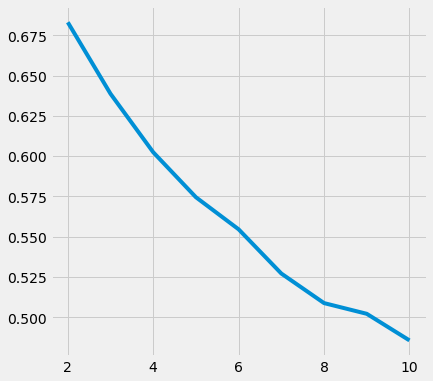

In [57]:
plt.style.use("fivethirtyeight")
plt.figure(figsize=(6, 6))
plt.plot(
    range(2, 11),
    silhouette_scores,
    c="#008fd5",
    label="Silhouette Coefficient",
)
plt.plot(range(2, 11), sse, c="#fc4f30", label="SSE")

plt.xlabel("n_components")
plt.legend()
plt.title("Clustering Performance as a Function of n_components")
plt.tight_layout()
plt.show()

# Combination Code

In [15]:
#create a final dataset with cluster group included
print(RFM_km.head())
#join to customer behavior table based on clusterID
# customer_behavior.head()

# recommender_data = customer_behavior[['customer_id_', 'vendor_id_nunique', 'deliverydistance_mean', 'item_count_mean',
#                                      'Recency', 'days_bw_visits', 'oders_per_location', 'vendor_rating_y_mean', 
#                                      'delivery_charge_mean', 'prepration_time_mean', 'breakfast_r', 'lunch_r', 
#                                      'dinner_r', 'late_nigh_r']]
# recommender_data = RFM_km.merge(recommender_data, left_on='CustomerID', right_on='customer_id_')
# recommender_data.head()

recommender_data= RFM_km

  CustomerID  grand_total_sum  breakfast_r   lunch_r  delivery_charge_mean  \
0    005ECL6             48.7          0.0  0.000000              0.700000   
1    009UFS1             29.6          0.0  0.000000              0.525000   
2    00GV4J4             37.4          0.0  0.666667              0.233333   
3    00HRRAK            106.3          0.0  0.333333              0.000000   
4    00HWUU3             37.2          0.0  0.166667              0.233333   

   oders_per_location  dinner_r  late_nigh_r  Recency  ClusterID  
0                 2.0  0.500000     0.500000     43.0          2  
1                 1.0  0.000000     1.000000     79.0          1  
2                 1.0  0.000000     0.333333     30.0          2  
3                 2.0  0.500000     0.166667      4.0          0  
4                 1.0  0.333333     0.500000     60.0          1  


# Recommendation System

In [86]:
#finding the default value
r_matrix = orders.pivot_table(values='order_count', index='customer_id', columns='vendor_id', aggfunc=np.sum)
r_matrix.head()
means = r_matrix.mean()
means.mean()

1.860648291145774

In [87]:
#users as column, each vendor ID as a column
orders.head()
r_matrix = orders.pivot_table(values='order_count', index='customer_id', columns='vendor_id', aggfunc=np.sum)
# r_matrix = r_matrix.fillna(0)
r_matrix.head()
# orders.head()

vendor_id,4,13,20,23,28,33,43,44,55,66,67,75,76,78,79,81,82,83,84,85,86,90,92,104,105,106,110,113,115,134,145,148,149,154,157,159,160,161,176,180,188,189,191,192,193,195,196,197,199,201,203,207,216,221,225,231,237,243,250,259,265,271,274,288,289,294,295,298,299,300,303,304,310,356,386,391,398,401,419,459,537,547,573,575,577,578,582,583,676,679,681,841,843,845,846,849,855,856,858,907
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
000THBA,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
002510Y,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
005ECL6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0075AM7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
009UFS1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [88]:
# # if vendor_id in r_matrix:
# sum_orders = r_matrix['vendor_id'].mean()
# mean_rating = r_matrix['vendor_id'].mean()

In [89]:
#Import the train_test_split function
from sklearn.model_selection import train_test_split
 #Assign X as the original ratings dataframe and y as the user_id column of ratings.

baseline_data = orders[['order_count', 'customer_id', 'vendor_id']]
X = baseline_data.groupby(['customer_id', 'vendor_id']).sum().reset_index()
X.head()
y = X['customer_id']
 #Split into training and test datasets, stratified along user_id
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state=42)



## Reccommendation On Whole Dataset

### Baseline

In [90]:
%%time
from sklearn.metrics import mean_squared_error
def rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))
def baseline(CustomerID, vendor_id):
    return 1.86

def score(cf_model):
     #Construct a list of user-movie tuples from the testing dataset
    id_pairs = zip(X_test['customer_id'], X_test['vendor_id'])
     #Predict the rating for every user-movie tuple
    y_pred = np.array([cf_model(CustomerID, vendor_id) for (CustomerID, vendor_id) in id_pairs])
     #Extract the actual ratings given by the users in the test data
    y_true = np.array(X_test['order_count'])
     #Return the final RMSE score
    return rmse(y_true, y_pred)

Wall time: 0 ns


In [91]:
baseline(X_test['customer_id'], X_test['vendor_id'])

1.86

In [92]:
score(baseline)

2.478914850289145

### Mean Collaborative Filtering

The value being predicted is the sum of times a customer orders from the restaurant in question.
The values are the sum of times a customer ordered from a restuarant, if the customer has not been to the restaurant, there is a sum of 1
For the mean model it's the average amount of times a customer has been to the restaurant across all users who have been to that restaurant
This is because we need to detect repeat trips, if a customer has not been to a restaurant it could be out of their delivery distance or they simply may not have noticed it. It's probably unlikely that this means they are completely opposed to going to the restaurant. 


In [23]:
%%time

#User Based Collaborative Filter using Mean Ratings
def cf_user_mean(customer_id, vendor_id):
#      #Check if movie_id exists in r_matrix
    if vendor_id in r_matrix:
#         #Compute the average frequency of the restaurant
        mean_rating = r_matrix[vendor_id].mean()
    else:
#         #Default to a rating of 3.0 in the absence of any information
        mean_rating = 1.86
    return mean_rating
 #Compute RMSE for the Mean model
score(cf_user_mean)

Wall time: 8.56 s


2.439671604637826

### Weighted Mean Collaborative Filtering

In [24]:
#Create a dummy ratings matrix with all null values imputed to 0
r_matrix_dummy = r_matrix.copy().fillna(0)
# Import cosine_score 
from sklearn.metrics.pairwise import cosine_similarity
#Compute the cosine similarity matrix using the dummy ratings matrix
cosine_sim = cosine_similarity(r_matrix_dummy, r_matrix_dummy)
#Convert into pandas dataframe 
cosine_sim = pd.DataFrame(cosine_sim, index=r_matrix.index, columns=r_matrix.index)
cosine_sim.head(10)

customer_id,000THBA,002510Y,005ECL6,0075AM7,009UFS1,00F8I3F,00FQ1U9,00GV4J4,00HRRAK,00HWUU3,00M7NA5,00NAL8D,00OT8JX,00QC44G,00QIIMH,00R9C57,00S9BTQ,00U89UY,00VBYA9,00Z2BPR,00Z403U,010DVV3,017J1M0,018GT0H,0198LZL,019ILOE,01BY7WQ,01DDBP3,01DSQ03,01E7ZHU,01HG648,01JF6J2,01KX5Q8,01L565T,01LC14G,01PXZKF,01QRJWD,01RMLT7,01SYH2W,01UF9UR,01WXG2E,01XQ398,020NUVD,022H66T,024JJVJ,026DLQY,0282DXQ,028L9YA,029XH91,02BFXNO,02C0DWD,02C5VSM,02CJVDG,02EVEAZ,02G76GA,02HI6HS,02I3W4Y,02LQ6XD,02MCCTV,02Q9OLI,02QYVDI,02REA7X,02SFNJH,02SQ94N,02Y4HXJ,030RSXK,032TAZ0,0359WBJ,036OYRE,037HIN2,037UFQH,03A5JNU,03AADDM,03E01HL,03FKIZR,03GI2UX,03HMY4W,03I0IGC,03K46LZ,03KC7Q8,03LN6SP,03MYN9R,03O25YX,03OEKF1,03OQ7QU,03P9BDX,03QG113,03VOLT2,03WD28H,03XLD1E,0403E0I,042XOSW,043OOAD,045FUZC,046EKTU,046FK0C,047LNHS,0480B40,049BJCO,04AMI62,04AWPBE,04B8UUG,04EZNQE,04HS503,04LF0UN,04M5T56,04O83N3,04ODHKK,04SMM6S,04TSSTV,04VARUV,04VLVWQ,04VYBRM,051A06M,054Y8DR,055MN2K,057OGLT,05GXQ8K,05JFHEP,05JRQK1,05LJNFC,05LL4LB,05PQFON,05QSOVV,05R3BKO,05U3JC7,05UGY71,05XZS3F,05ZLG31,061WI5J,062LSV7,062ZGPJ,0660QP7,066NSPH,067B5UK,067ZTKD,06AJCQD,06E9VIK,06F9LTV,06GXGSC,06HKPQX,06IFYTY,06KCWZW,06LMVC5,06N72EV,06Q258W,06QH4V1,06SG2EQ,06V4ZR4,06W4Q9Z,06XISPH,06XJCUO,07294KB,072LAHO,0756XNS,075MP8R,0772ZHJ,0787A3K,078QLD4,079I4NF,07CCW9F,07CO9SV,07DO4CM,07DYES0,07DZ7A4,07F37MR,07FE2FT,07G9OMN,07OUDRP,07PB2W3,07PMAMN,07SK0NA,07YFAFL,081WCH3,082C92S,084CLP4,085PW1K,086HGJH,086S0XK,087NN6I,0880R2V,088BPLC,088J47N,089OGP9,08AEQ10,08BB1CN,08DDKQF,08ES9KZ,08F2YRP,08PA3QO,08PL9NF,08PSNX7,08TXX9T,08Y6DYQ,08ZDT10,0903VHK,090HRC5,092N1TK,098AGWK,099123Y,09A31JX,09AMMCI,09C1RHB,09IGF4L,09K01P3,09M8OKR,09N4LLE,09NXGRH,09ON7ER,09PW8ST,09Q8XMF,09UK6D9,09UOV4M,09WIVKI,09X9ZSY,09XR9GG,09Z9QF9,0A0K6JL,0A41QYP,0A7B4ZD,0AAO8TP,0AE8QGM,0AH7UA9,0AHQ3ZG,0AL7H0L,0ANQV35,0ARG139,0AS3T3Q,0ASF917,0AULQ4Y,0AXTVXU,0B071OX,0B0FBZX,0B23SVJ,0B3QNQ5,0B40SC6,0B7680O,0BBHKHM,0BFP1CI,0BGWB9P,0BHOJIP,0BHQWOQ,0BITNUZ,0BJCRNV,0BKG3DH,0BM5OJ6,0BN9G4T,0BNFTAB,0BO68T2,0BPIFTG,0BTFIDS,0BTJE4G,0BXMCPT,0BZ621B,0C078J6,0C32CU5,0C3AB62,0C3VH30,0C7AQRE,0C9TR4E,0C9WP58,0CCBJC2,0CHV11Z,0CIQ3AL,0CKSEHE,0CLSXU2,0CPXPLF,0CSCAH6,0CVNXZN,0CWS0C3,0D18F5T,0D2MTX1,0D3N7RS,0D5BCBK,0D9JLPA,0DAKWP8,0DC0XAI,0DDLFSF,0DI3YFO,0DK0V5Q,0DKK2IZ,0DKVTGZ,0DMNXLG,0DN7GLR,0DO8QY5,0DOGR1P,0DOHXFH,0DS79SZ,0DSR94W,0DT7TCF,0DV83M4,0DWJJO4,0DYJLOF,0DZN1C0,0E1OG8B,0E55VUX,0E5WEOJ,0E648BQ,0E919IW,0EARL1F,0ECDDSB,0ECUMBT,0EDFG78,0EFOYKO,0EFQ9C8,0EFSYC0,0EI9952,0EJIU3Y,0ELL7U0,0EMG43U,0EMPWQW,0ENW8K2,0ENZPXC,0EP019J,0ER4XZ4,0ER64GH,0ESSD9Z,0EUY67F,0EWJ2FB,0EWNTZV,0EY4ZBG,0F01IOM,0F049DE,0F0FY09,0F0IE47,0F3AF63,0F3X3SF,0F3YWPW,0F5ZCZJ,0F81JN3,0F8T49W,0F8TE9V,0F8YO3R,0FBSANU,0FGFVJD,0FI0NKK,0FNAOSG,0FNM7FT,0FOCFVI,0FR472Q,0FTCC49,0FUADMH,0FWIT1W,0FXJBR0,0FYO7WM,0FYP7A4,0FYZ6FD,0G0RMIV,0G354BQ,0G3EYMW,0G4J6KZ,0G5Q316,0G6BKDW,0G8T9ES,0GA59YJ,0GCJEBK,0GG2MD2,0GIN1QD,0GKC78Z,0GKTXC4,0GNZ58Y,0GPGH86,0GQ7OES,0GQAWGX,0GUE0FH,0GW8QX0,0GWG43Q,0GWTVXM,0GZGDVI,0H20BYF,0H2P7W1,0H2QQYA,0H2Z21N,0H48AZC,0H5HJ4U,0H5X6WN,0H6INNZ,0H6ZBES,0H9Y5N6,0HA648F,0HBDXH4,0HCDBI9,0HCVHZ7,0HDNF84,0HDXV8U,0HEPZP6,0HFD65E,0HGGXJE,0HI3HE5,0HI5J8P,0HITBVB,0HIY917,0HMKWHG,0HN6GXM,0HR6D9F,0HRW964,0HSSAVS,0HSSVEZ,0HUFP7Y,0HUMB5G,0HXHJVS,0I2YCHB,0I4326W,0I441V4,0I8VJPS,0IBXAM0,0IDUDPL,0IF97OA,0IGKHOY,0IHN5L2,0II5U7A,0IIE61O,0IJEBAD,0IKT962,0IKTY65,0ISANP8,0ISIUM2,0IUN98D,0IV6ELH,0IXYEJ7,0IZ6XQH,0IZR69I,0IZX8X4,0J3JAWH,0J622JL,0J6JL7F,0J8DL5R,0J8JV5J,0JH1Q3Q,0JKB7JF,0JKXS9E,0JLBU07,0JNBSMC,0JOZNH1,0JPMHOU,0JQ9SGJ,0JU5CIV,0JVOQHX,0JY8DIN,0K0OJLB,0K55AFU,0K5EARA,0K6LVL9,0K85S2P,0KA8LJW,0KCQARF,0KCUOQQ,0KEID5U,0KFO26T,0KIY63N,0KKEHS7,0KL8Z4K,0KLGDU0,0KLVQAX,0KM0A7H,0KND4GI,0KOFEET,0KQF479,0KR4CB8,0KUSTFH,0KZXA52,0L20GPL,0L7ZII9,0L8QH8Z,0L9MOV2,0LB4U73,0LC6K27,0LC8BK9,0LCQY60,0LCU0AH,0LD14XS,0LEP566,0LFIRRX,0LFS2HM,0LGFRVJ,0LISIKE,0LMXLU3,0LP3JN6,0LXDY8Z,0LXTS5C,0M3O0TL,0M4CQ9Y,0M8RKSH,0M8YPYV,0M94LCK,0M9CZLY,0M9RZ3P,0MBT2J5,0MDBVPG,0MGEJ9M,0MGKJLG,0MH75R0,0ML9O5F,0MMZV0F,0MNB9AY,0MQ1BEO,0MWCYPS,0N03YCJ,0N49

In [25]:
%%time
#User Based Collaborative Filter using Weighted Mean Ratings
def cf_user_wmean(customer_id, vendor_id):
     #Check if movie_id exists in r_matrix
    if vendor_id in r_matrix:
         #Get the similarity scores for the user in question with every other user
        sim_scores = cosine_sim[customer_id]
 #Get the user ratings for the movie in question
        m_ratings = r_matrix[vendor_id]
 #Extract the indices containing NaN in the m_ratings series
        idx = m_ratings[m_ratings.isnull()].index
 #Drop the NaN values from the m_ratings Series
        m_ratings = m_ratings.dropna()
#Drop the corresponding cosine scores from the sim_scores series
        sim_scores = sim_scores.drop(idx)
         #Compute the final weighted mean
        wmean_rating = np.dot(sim_scores, m_ratings)/ sim_scores.sum()
    else:
 #Default to a rating of 3.0 in the absence of any information
         wmean_rating = 1.86
    return wmean_rating
score(cf_user_wmean)



Wall time: 53min 27s


2.432788050584239

In [ ]:
#Demographic but use cluster group instead
    #check for increased efficiency & model improvemen

In [ ]:
#item based

In [ ]:
#Hybrid Model
    #take in a restaurant and customer as input
    #use a content-based model to compute the 25 most similar restaurants
    #compute the predicted ratings that the user might give these 25 restaurants using a collaborative based filter
    #return the top 10 restaurants with the highest predicted rating

## Recommendation with Cluster Group Pre-Filters

In [95]:
#data prep
RFM_km.head()
#attach cluster group to the orders dataset
orders.head()
clustergroups = RFM_km[['CustomerID', 'ClusterID']]
clustergroups.head()
neworders = orders.merge(RFM_km, left_on='customer_id', right_on='CustomerID')
neworders.head()

# #finding the default values
r_matrix = neworders.pivot_table(values='order_count', index=['customer_id', 'ClusterID'], columns='vendor_id', aggfunc=np.sum)
r_matrix.head(10)
# r_matrix.columns

    #cluster 0
cluster0 = r_matrix.query('ClusterID == 0')
cluster0.head()
means0 = cluster0.mean()
print(means0.mean())

    #cluster 1
cluster1 = r_matrix.query('ClusterID == 1')
cluster1.head()
means1 = cluster1.mean()
print(means1.mean())

    #cluster 2
cluster2 = r_matrix.query('ClusterID == 2')
cluster2.head()
means2 = cluster2.mean()
print(means2.mean())


2.253511168607508
1.3573513708236664
1.6054665398685812


In [96]:
#Import the train_test_split function
from sklearn.model_selection import train_test_split
 #Assign X as the original ratings dataframe and y as the user_id column of ratings.

baseline_data = neworders[['order_count', 'customer_id', 'vendor_id', 'ClusterID']]
X = baseline_data.groupby(['customer_id', 'vendor_id', 'ClusterID']).sum().reset_index()
X.head()
y = X['customer_id']
 #Split into training and test datasets, stratified along user_id
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state=42)


### Baseline

In [97]:
X_test

,customer_id,vendor_id,ClusterID,order_count
5314,2YXLN4W,299,0,2
3661,22CE6DL,82,0,2
54718,W12RFGR,81,0,1
10572,6013PWK,298,0,1
26192,F2KNG9H,216,0,1
...,...,...,...,...
39595,N3RKK4C,221,1,2
27969,G3X17NA,176,0,3
32459,IY4FMQT,44,0,1
29726,HC1IZ0U,221,0,2


In [98]:
%%time
#instead of a standard 1.86 as the predicted value, it's now going to be the average from the cluster group
from sklearn.metrics import mean_squared_error
def rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))
# def baseline(CustomerID, vendor_id):
#     if X_test['ClusterID'] == 0:
#         cluster_score = 2.25
#     if X_test['ClusterID'] == 1:
#         cluster_score = 1.36
#     else:
#         cluster_score = 1.61
#     return cluster_score

def baseline(CustomerID, vendor_id):
    return 1.86

def score(cf_model):
     #Construct a list of user-movie tuples from the testing dataset
    id_pairs = zip(X_test['customer_id'], X_test['vendor_id'])
     #Predict the rating for every user-movie tuple
    y_pred = np.array([cf_model(CustomerID, vendor_id) for (CustomerID, vendor_id) in id_pairs])
     #Extract the actual ratings given by the users in the test data
    y_true = np.array(X_test['order_count'])
     #Return the final RMSE score
    return rmse(y_true, y_pred)

Wall time: 1.99 ms


In [99]:
baseline(X_test['customer_id'], X_test['vendor_id'])

1.86

In [100]:
score(baseline)

2.3606771201704957

In [101]:
neworders.head()

,akeed_order_id,customer_id,item_count,grand_total,payment_mode,promo_code,vendor_discount_amount,promo_code_discount_percentage,is_favorite,is_rated,vendor_rating,driver_rating,deliverydistance,preparationtime,delivery_time,order_accepted_time,driver_accepted_time,ready_for_pickup_time,picked_up_time,delivered_time,delivery_date,vendor_id,created_at,LOCATION_NUMBER,LOCATION_TYPE,CID X LOC_NUM X VENDOR,order_count,just_date,hour,breakfast,lunch,dinner,late_night,total,CustomerID,grand_total_sum,breakfast_r,lunch_r,delivery_charge_mean,oders_per_location,dinner_r,late_nigh_r,Recency,ClusterID
0,163238.0,92PEE24,1.0,7.6,2,NaN,0.0,NaN,NaN,No,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-07-31 05:30:00,105,2019-08-01 05:30:16,0,NaN,92PEE24 X 0 X 105,1,2019-08-01,5,1,0,0,0,1,92PEE24,32.6,0.5,0.0,0.00,4.0,0.0,0.5,204.0,1
1,164476.0,92PEE24,1.0,7.6,2,NaN,0.0,NaN,NaN,No,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-08-02 05:30:00,105,2019-08-03 05:21:30,0,Work,92PEE24 X 0 X 105,1,2019-08-03,5,1,0,0,0,1,92PEE24,32.6,0.5,0.0,0.00,4.0,0.0,0.5,204.0,1
2,168875.0,92PEE24,1.0,7.1,1,NaN,0.0,NaN,NaN,No,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-08-09 05:30:00,105,2019-08-09 23:01:30,0,Home,92PEE24 X 0 X 105,1,2019-08-09,23,0,0,0,1,1,92PEE24,32.6,0.5,0.0,0.00,4.0,0.0,0.5,204.0,1
3,135229.0,92PEE24,2.0,10.3,2,NaN,0.0,NaN,NaN,No,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-06-18 00:00:00,105,2019-06-18 23:41:36,1,Home,92PEE24 X 1 X 105,1,2019-06-18,23,0,0,0,1,1,92PEE24,32.6,0.5,0.0,0.00,4.0,0.0,0.5,204.0,1
4,163240.0,QS68UD8,1.0,8.7,1,NaN,0.0,NaN,NaN,No,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2019-07-31 05:30:00,294,2019-08-01 05:31:10,0,Work,QS68UD8 X 0 X 294,1,2019-08-01,5,1,0,0,0,1,QS68UD8,12.2,0.5,0.0,0.35,1.0,0.5,0.0,142.0,1


In [185]:
gender_mean = neworders[['vendor_id', 'ClusterID', 'order_count', 'customer_id']].groupby(['vendor_id', 'ClusterID'])['order_count'].sum()

In [188]:
gender_mean

vendor_id  ClusterID
4          0            1622
           1             161
           2             267
13         0             622
           1              38
                        ... 
858        1              46
           2             183
907        0             251
           1              62
           2             132
Name: order_count, Length: 300, dtype: int64

In [191]:
type(gender_mean)

pandas.core.series.Series

In [194]:
cluster_freq

Frequency
vendor_id_ ClusterID_           
4          0            2.749153
           1            1.319672
           2            1.977778
13         0            2.879630
           1            1.407407
...                          ...
858        1            1.352941
           2            1.537815
907        0            4.482143
           1            2.214286
           2            2.750000

[300 rows x 1 columns]

In [195]:
series1 = cluster_freq.iloc[0,:]

In [197]:
series1

Frequency    2.749153
Name: (4, 0), dtype: float64

In [199]:
cluster_freq = cluster_freq.stack()

In [166]:
#compute the frequency average of every restaurant by cluster group
cluster_freq = neworders[['ClusterID', 'vendor_id', 'order_count', 'customer_id']]
cluster_freq.head()
cluster_freq = cluster_freq.groupby(['vendor_id', 'ClusterID']).agg({'customer_id' : ['nunique'],
                                                                   'order_count' : ['sum']}).reset_index()
cluster_freq.columns = list(map('_'.join, cluster_freq.columns.values))

cluster_freq['Frequency'] = cluster_freq['order_count_sum']/cluster_freq['customer_id_nunique']
cluster_freq.head()
cluster_freq = cluster_freq[['ClusterID_', 'vendor_id_', 'Frequency']]
cluster_freq.head()


,ClusterID_,vendor_id_,Frequency
0,0,4,2.749153
1,1,4,1.319672
2,2,4,1.977778
3,0,13,2.879630
4,1,13,1.407407


In [167]:
r_matrix.head(20)

,vendor_id,4,13,20,23,28,33,43,44,55,66,67,75,76,78,79,81,82,83,84,85,86,90,92,104,105,106,110,113,115,134,145,148,149,154,157,159,160,161,176,180,188,189,191,192,193,195,196,197,199,201,203,207,216,221,225,231,237,243,250,259,265,271,274,288,289,294,295,298,299,300,303,304,310,356,386,391,398,401,419,459,537,547,573,575,577,578,582,583,676,679,681,841,843,845,846,849,855,856,858,907
customer_id,ClusterID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
005ECL6,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
009UFS1,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
00GV4J4,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
00HRRAK,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
00HWUU3,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
00M7NA5,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
00NAL8D,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
00OT8JX,0,23.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,2.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.0,NaN,NaN,1.0,NaN,1.0,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN
00QIIMH,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [168]:
RFM_km.head()

,CustomerID,grand_total_sum,breakfast_r,lunch_r,delivery_charge_mean,oders_per_location,dinner_r,late_nigh_r,Recency,ClusterID
0,005ECL6,48.7,0.0,0.000000,0.700000,2.0,0.500000,0.500000,43.0,2
1,009UFS1,29.6,0.0,0.000000,0.525000,1.0,0.000000,1.000000,79.0,1
2,00GV4J4,37.4,0.0,0.666667,0.233333,1.0,0.000000,0.333333,30.0,2
3,00HRRAK,106.3,0.0,0.333333,0.000000,2.0,0.500000,0.166667,4.0,0
4,00HWUU3,37.2,0.0,0.166667,0.233333,1.0,0.333333,0.500000,60.0,1


In [169]:
customers = RFM_km.set_index('CustomerID')

In [170]:
customers.head()

,grand_total_sum,breakfast_r,lunch_r,delivery_charge_mean,oders_per_location,dinner_r,late_nigh_r,Recency,ClusterID
CustomerID,,,,,,,,,
005ECL6,48.7,0.0,0.000000,0.700000,2.0,0.500000,0.500000,43.0,2
009UFS1,29.6,0.0,0.000000,0.525000,1.0,0.000000,1.000000,79.0,1
00GV4J4,37.4,0.0,0.666667,0.233333,1.0,0.000000,0.333333,30.0,2
00HRRAK,106.3,0.0,0.333333,0.000000,2.0,0.500000,0.166667,4.0,0
00HWUU3,37.2,0.0,0.166667,0.233333,1.0,0.333333,0.500000,60.0,1


In [171]:
cluster = customers.loc['005ECL6']['ClusterID']
cluster
cluster_freq.head()

,ClusterID_,vendor_id_,Frequency
0,0,4,2.749153
1,1,4,1.319672
2,2,4,1.977778
3,0,13,2.879630
4,1,13,1.407407


In [172]:
vendor_id = cluster_freq.set_index(['vendor_id_', 'ClusterID_'])

In [173]:
cluster_freq = vendor_id

In [174]:
cluster_freq

Frequency
vendor_id_ ClusterID_           
4          0            2.749153
           1            1.319672
           2            1.977778
13         0            2.879630
           1            1.407407
...                          ...
858        1            1.352941
           2            1.537815
907        0            4.482143
           1            2.214286
           2            2.750000

[300 rows x 1 columns]

In [204]:
%%time
#define a function that identifies the cluster of the customer, extracts the average frequency 
#given to that restaurant by the particular cluster and return that value as output

def cf_cluster(customer_id, vendor_id):
#Check if movie_id exists in r_matrix (or training set)
    if vendor_id in r_matrix:
        #Identify the gender of the user
        cluster = customers.loc[customer_id]['ClusterID']
         #Check if the gender has rated the movie
        if cluster in cluster_freq[vendor_id]:
             #Compute the mean rating given by that gender to the movie
            cluster_frequency = cluster_freq[vendor_id][cluster]
        else:
            cluster_frequency = 1.86
    else:
        #Default to a rating of 3.0 in the absence of any information
        cluster_frequency = 1.86
    return cluster_frequency
score(cf_cluster)


Wall time: 17 s


2.26963747993558

### Mean

In [ ]:
#instead of the mean rating of the vendor overall, mean ratining within the cluster group

### Weighted Mean